# My Mask R-CNN Implementation

##### Authored by [Tal Rave](https://www.linkedin.com/in/tal-rave-59833715a)

## Table of Contents

- [Introduction](#int)
- [Motivation](#mot)
- [Data](#dat)
- [Models](#mod)
- [Learning](#lea)
- [Inference](#inf)
- [Discussion](#dis)
- [References](#ref)
- [Appendix](#app)

<a id='int'></a>
## Introduction

In this project I will present my unique implementation of Mask R-CNN [[1](https://arxiv.org/abs/1703.06870)] - this popular network performs object detection, classification, and instance segmentation by predicting bounding boxes, class labels, and binary segmentation masks for all the objects in the image. I should note that my implementation deviates quite a bit from the original; I will explain all in detail throughout the project.

<a id='mot'></a>
## Motivation 

During the last year of my computer science studies in the university (B.Sc. CS), I became very interested in the fields of computer vision and deep learning. After graduating, I decided to expand my knowledge in these fields by reading a few books; after reading [[2](https://www.amazon.com/Hands-Machine-Learning-Scikit-Learn-TensorFlow/dp/1492032646/ref=sr_1_1?dchild=1&keywords=machine+learning&qid=1633241659&sr=8-1)] I decided to apply some of what I've learned by doing this challenging project. My main goal was to gain significant experience in working with Keras and TensorFlow deep learning libraries.

<a id='dat'></a>
## Data 

As per [[1](https://arxiv.org/abs/1703.06870)], I will use the COCO dataset [[3](https://cocodataset.org/#home)] (I use the 2017 version) - this dataset contains ~118k training images and is provided with a convenient API. Every image in the dataset contains a variable number of common objects, each belonging to one of 80 different classes (e.g., 'person', 'car', 'chair', etc.).

Without further ado, let's load the metadata and check the relevant distributions...

In [283]:
import pandas as pd
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
%matplotlib inline


# data paths on my system (stored on a fast NVMe drive)
path = 'E:/'
cocoPath = path + 'coco/'
trainImgPath = cocoPath + 'train2017/'
valImgPath = cocoPath + 'val2017/'
testImgPath = cocoPath + 'test2017/'
trainAnnPath = cocoPath + 'annotations_trainval2017/annotations/instances_train2017.json'
valAnnPath = cocoPath + 'annotations_trainval2017/annotations/instances_val2017.json'


# load COCO metadata
trainCOCO = COCO(trainAnnPath)
trainImgIds = trainCOCO.getImgIds()
trainImgs = trainCOCO.loadImgs(trainImgIds)
trainAnnIds = trainCOCO.getAnnIds()
trainAnns = trainCOCO.loadAnns(trainAnnIds)
valCOCO = COCO(valAnnPath) 
valImgIds = valCOCO.getImgIds()
valImgs = valCOCO.loadImgs(valImgIds)
valAnnIds = valCOCO.getAnnIds()
valAnns = valCOCO.loadAnns(valAnnIds)
catIds = trainCOCO.getCatIds()
cats = trainCOCO.loadCats(catIds)

loading annotations into memory...
Done (t=16.24s)
creating index...
index created!
loading annotations into memory...
Done (t=0.57s)
creating index...
index created!


The above code initializes two COCO objects - 'trainCOCO' and 'valCOCO' - for the training and validation sets, respectively, which are then used to load the relevant metadata.

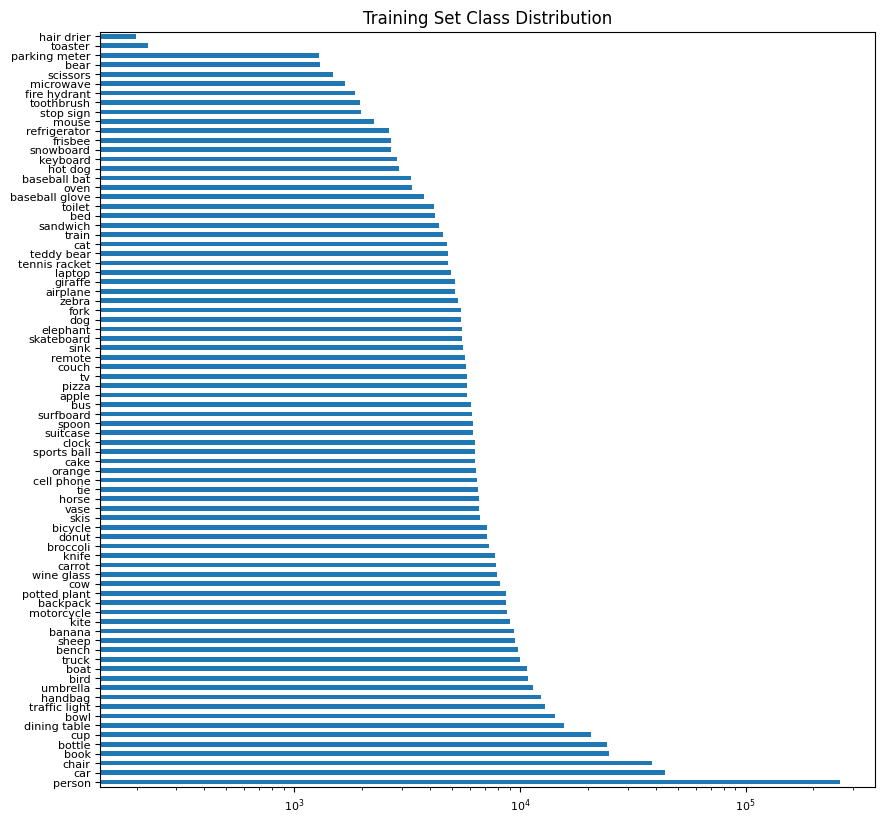

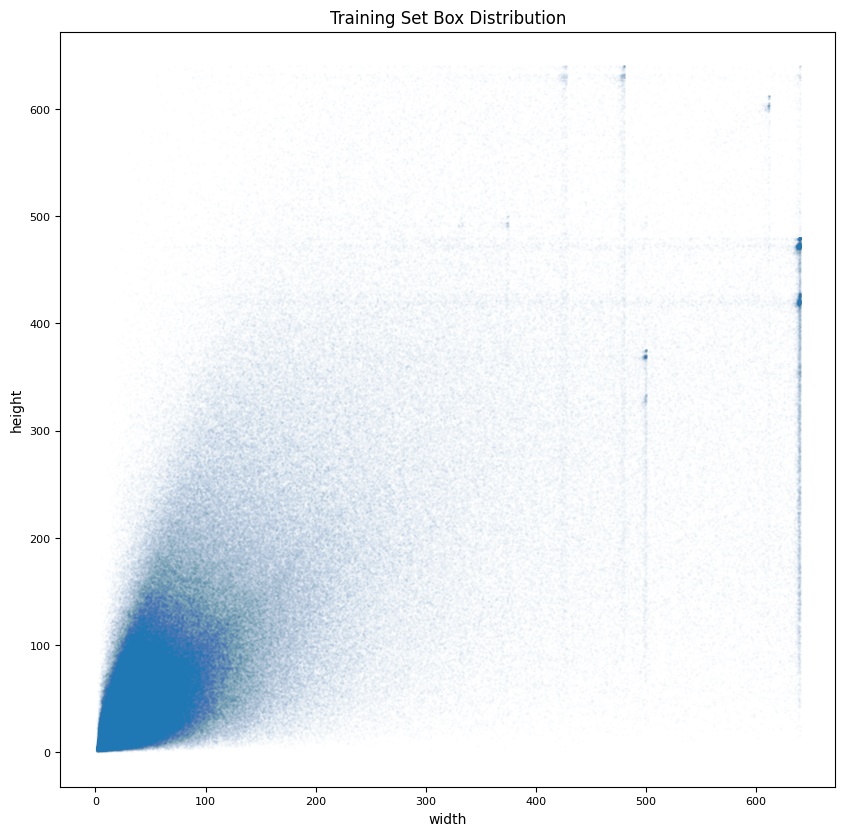

860001 annotations in total.


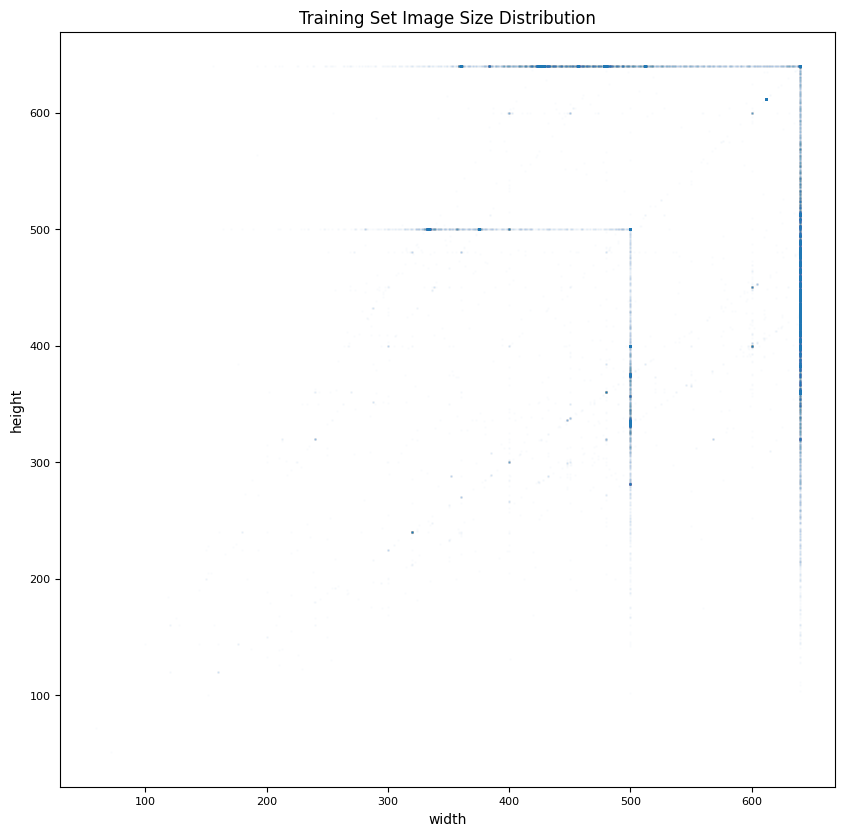

118287 images in total.


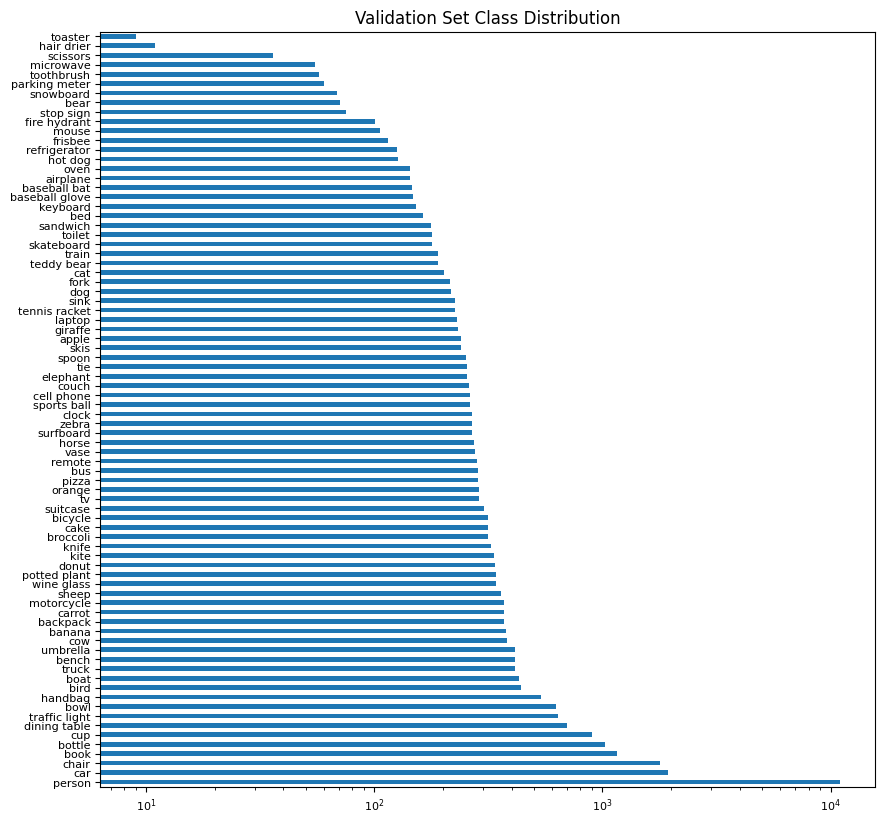

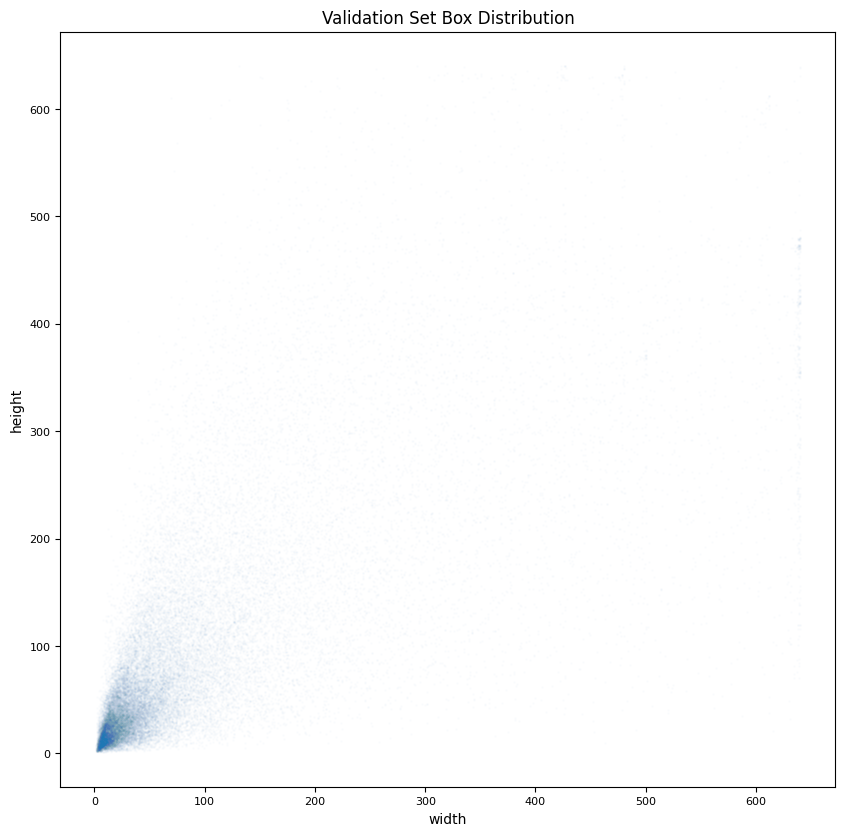

36781 annotations in total.


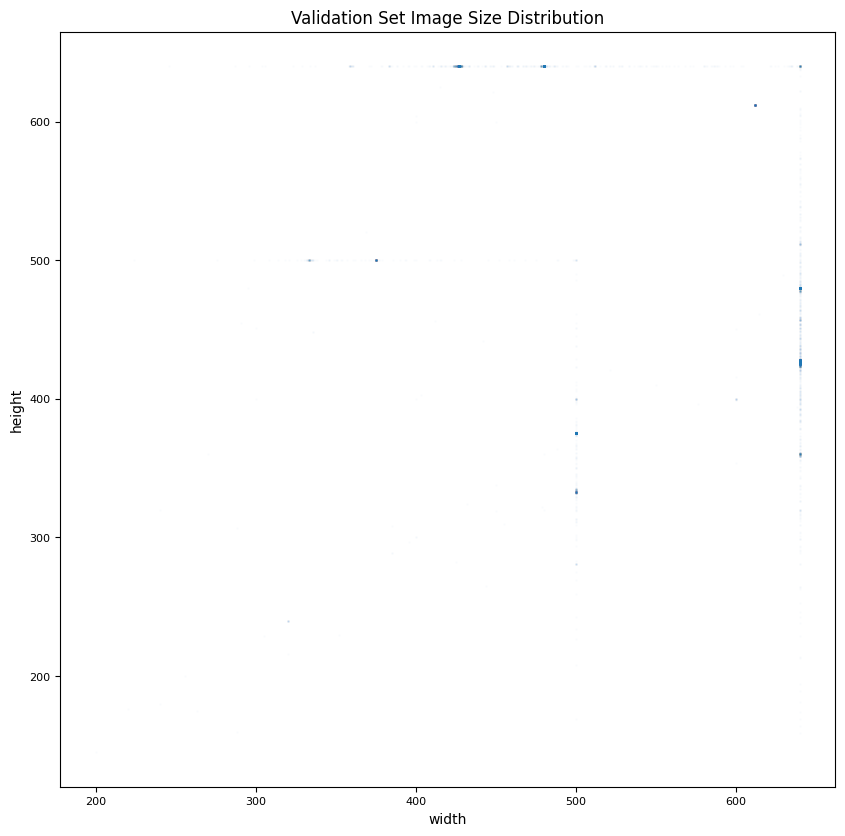

5000 images in total.


In [284]:
# map id to class name
catIdToName = {c['id'] : c['name'] for c in cats}


# this method receives a list of annotations and displays the class and bounding box distributions
def displayAnnDistrib(anns, title):
    df = pd.DataFrame(
        data=[[catIdToName[a['category_id']]] + [a['bbox'][2]] + [a['bbox'][3]] for a in anns], 
        columns=['name', 'width', 'height'])
    clsDistrib = df['name'].value_counts()
    plt.figure(figsize=(10,10), dpi=100)
    clsDistrib.plot(kind='barh', fontsize=8, logx=True, title=title+' Set Class Distribution')
    plt.show()
    plt.figure(figsize=(10,10), dpi=100)
    df[['width','height']].plot(
        kind='scatter', fontsize=8, x='width', y='height', 
        alpha=0.01, s=1, title=title+' Set Box Distribution', ax=plt.gca())
    plt.show()
    print(str(len(anns)) + ' annotations in total.')
    

# this method receives a list of image metadata and displays the image size distribution
def displayImgDistrib(imgs, title):
    df = pd.DataFrame(data=[[a['width']] + [a['height']] for a in imgs],
                      columns=['width','height'])
    plt.figure(figsize=(10,10), dpi=100)
    df[['width','height']].plot(
        kind='scatter', fontsize=8, x='width', y='height', 
        alpha=0.01, s=1, title=title+' Set Image Size Distribution', ax=plt.gca())
    plt.show()
    print(str(len(imgs)) + ' images in total.')
    

displayAnnDistrib(trainAnns, title='Training')
displayImgDistrib(trainImgs, title='Training')
displayAnnDistrib(valAnns, title='Validation')
displayImgDistrib(valImgs, title='Validation')

In the above figures we can see the class, box, and image size distributions of the training and validation sets, respectively (note that the class histograms are in log scale). In the training set we can see that some classes are much more common than others (the 'person' class in particular). In other words, there is class imbalance on the one hand, but on the other hand, the validation set is similarly imbalanced, and the more common classes are usually more complex as well. The training set is also quite big (i.e., ~860k annotations in total). Considering the above, I will avoid using class balancing methods during training (e.g., class weights). We can also see that there is significant variation in box scale and aspect ratio, though most objects are relatively small and extreme aspect ratios are uncommon. Lastly, we can see that most images have a width and/or height of either ~500 or ~700 pixels.

Let's display some images and annotations...

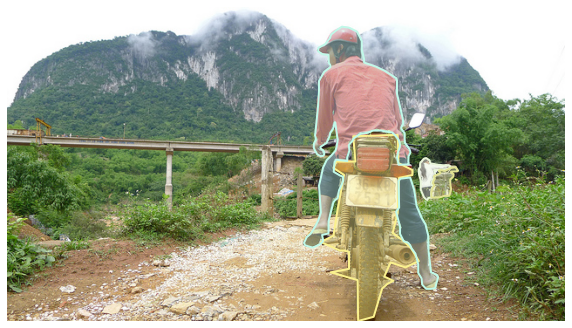

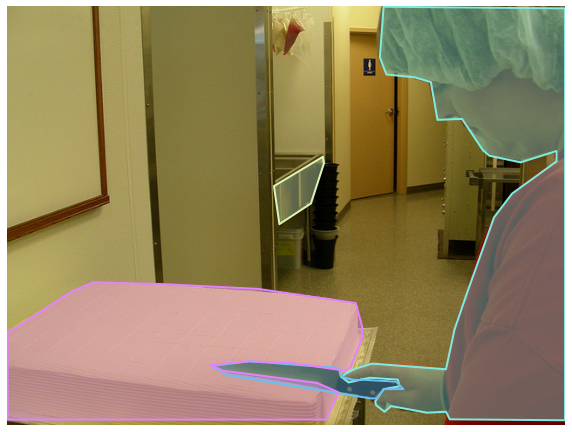

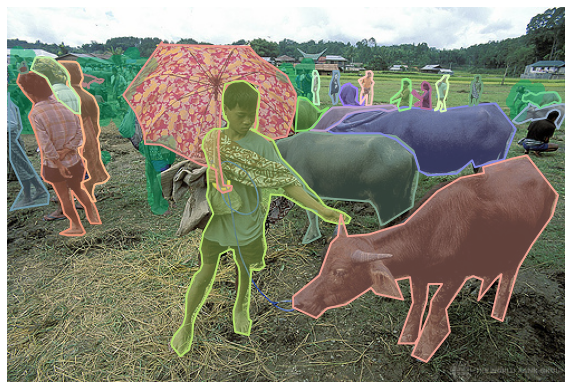

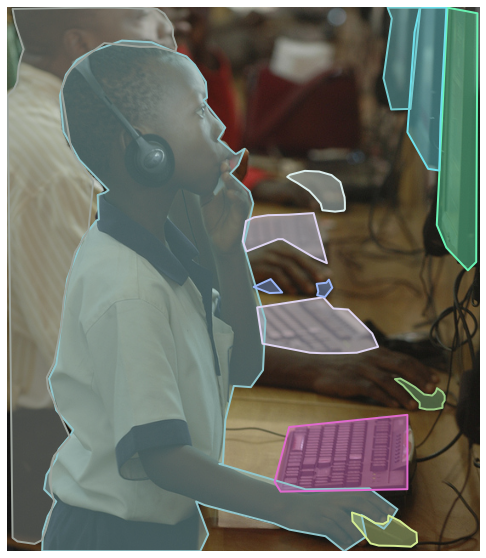

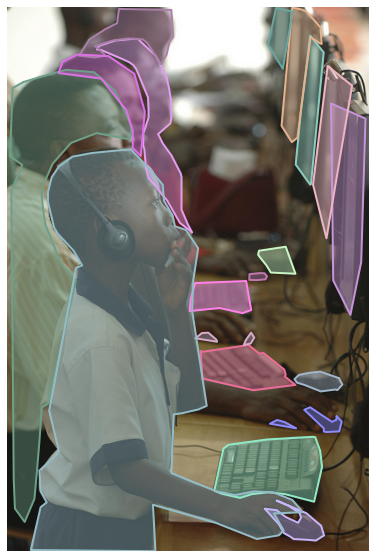

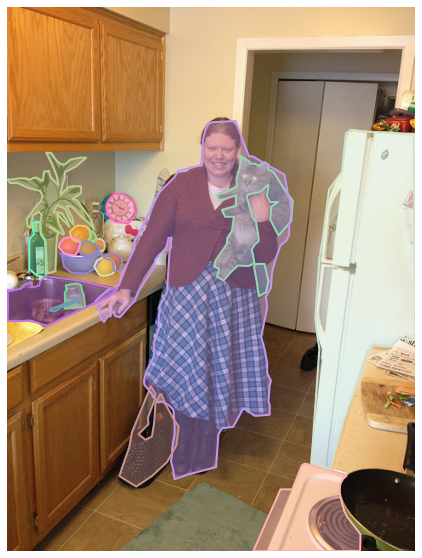

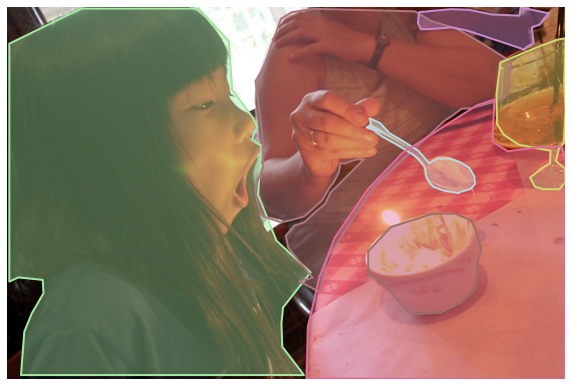

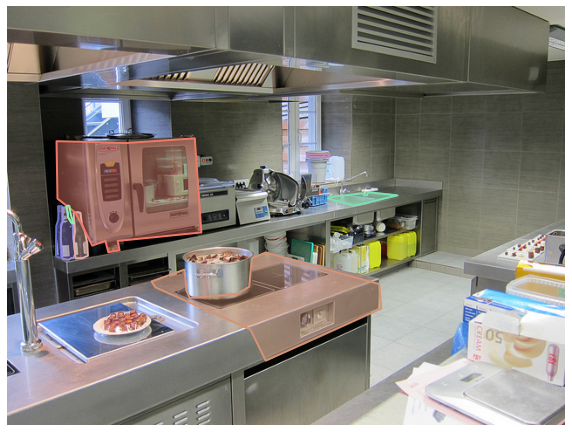

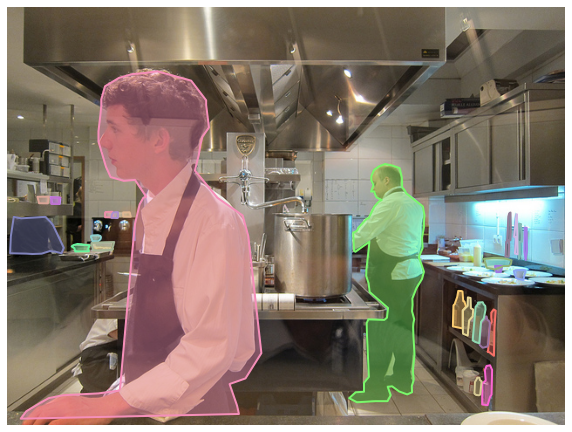

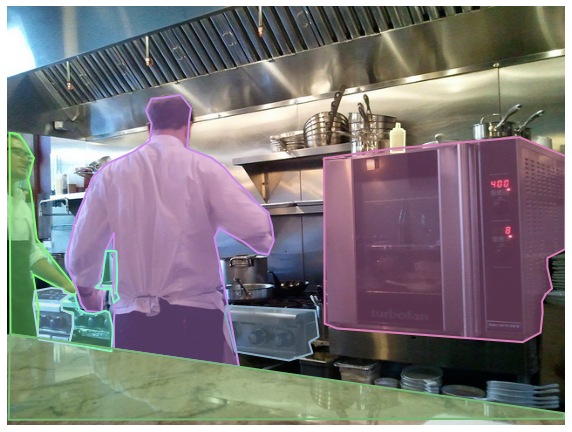

In [261]:
import cv2


for i in range(10):
    anns = trainCOCO.loadAnns(trainCOCO.getAnnIds([trainImgIds[i]]))
    cocoImg = trainCOCO.loadImgs(anns[0]['image_id'])[0]
    img = cv2.cvtColor(cv2.imread(trainImgPath+cocoImg['file_name']), cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10,10))
    plt.imshow(img)
    plt.axis('off')
    trainCOCO.showAnns(anns)
    plt.show()

We can see that some objects are occluded, and some are even made up from a few disconnected polygons. It certainly looks like a challenging dataset. Image size also varies, and so I will resize images along their largest dimension and pad them with zeroes such that all input images are normalized to shape (512,512,3) - this way, mini batches of images can be used as input to the network; such and other preprocessing procedures will be applied in real-time during training as we will see.

A key feature of Mask R-CNN is the use of so-called "anchors" [[1](https://arxiv.org/abs/1703.06870), [5](https://arxiv.org/abs/1506.01497)] (i.e., predetermined boxes of different scales/aspect ratios), that are predicted at every location on a grid; each anchor is predicted as either positive (i.e., contains an object) or negative. In my implementation I use a 64x64 grid and 32 different anchors per location (~131k anchors per image). Unlike the anchors used in [[5](https://arxiv.org/abs/1506.01497)], which are selected manually, I use k-means clustering so that the anchors would constitute a better prior with respect to the ground truth box distribution. I also ignore very small objects as they can't be reliably detected/classified anyway.

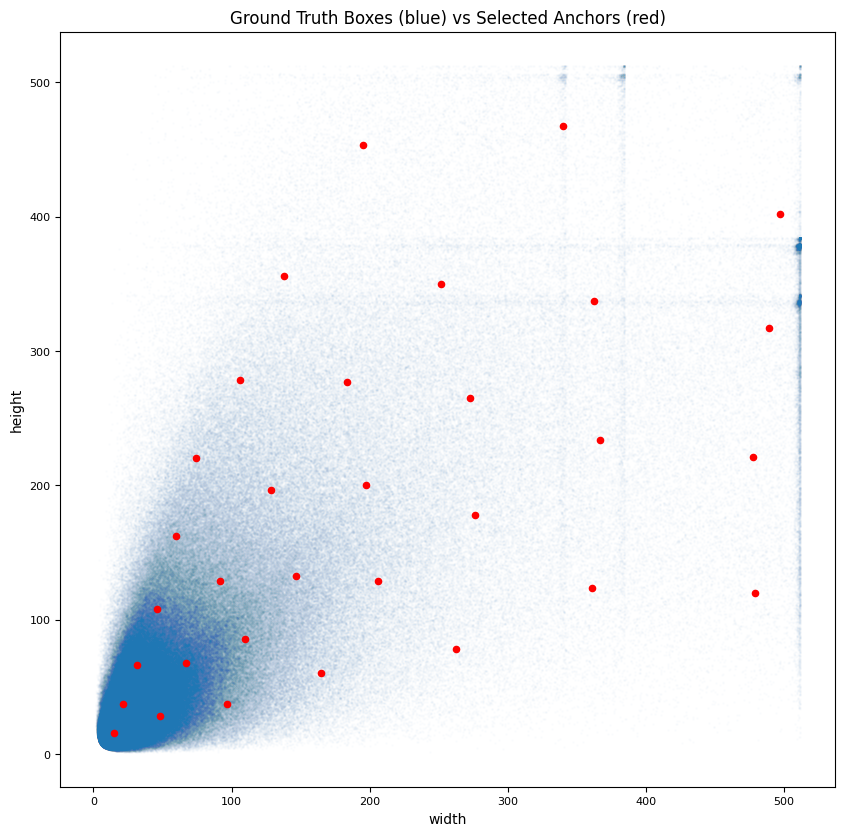

In [285]:
import numpy as np
from sklearn.cluster import KMeans


# network input image size
imgSize = 512
# the number of anchors used per grid location
ancNum = 32
# minimum area for a ground truth box
minBoxArea = 64


# get the box widths/heights
wh = []
for a in trainAnns:
    if a['iscrowd'] == 0 and a['bbox'][2] * a['bbox'][3] > minBoxArea:
        img = trainCOCO.loadImgs([a['image_id']])[0]
        # this accounts for image size normalization
        scale = imgSize / max([img['width'], img['height']]) 
        wh.append((scale * np.array(a['bbox']))[..., 2:])
wh = np.array(wh)


kmeans = KMeans(n_init=1, n_clusters=ancNum, init=np.zeros([ancNum,2])).fit(wh)
anchors = kmeans.cluster_centers_


plt.figure(figsize=(10,10), dpi=100)
pd.DataFrame(data=wh, columns=['width', 'height']).plot(
    kind='scatter', fontsize=8, x='width', y='height', 
    alpha=0.01, s=1, title='Ground Truth Boxes (blue) vs Selected Anchors (red)', ax=plt.gca())
plt.scatter(anchors[:,0], anchors[:,1], s=20, c='red')
plt.show()

The blue points and red points represent the relevant training ground truth boxes and the anchors selected by the k-means algorithm, respectively; we can see that the latter captures the distribution of the former quite well.

Note that the box distribution has a simple shape and contains no obvious outliers; therefore, the initial means have little effect on the final means (i.e., the selected anchors). For the sake of simplicity and determinism, I initialized all 32 means to the origin. Also note that the box dimensions were scaled to account for the image size normalization procedure I alluded to.

The grid anchors are needed for the data preparation procedure, so I define them here:

In [243]:
# create an array of anchors centered at the appropriate grid locations
gridSize = 64
gridAnchors = np.zeros((gridSize, gridSize, ancNum, 4), dtype=np.float32)
for i in range(gridSize):
    for j in range(gridSize):
        for k in range(ancNum):
            xmin = imgSize // gridSize * j - 0.5 * anchors[k][0]
            ymin = imgSize // gridSize * i - 0.5 * anchors[k][1]
            xmax = imgSize // gridSize * j + 0.5 * anchors[k][0]
            ymax = imgSize // gridSize * i + 0.5 * anchors[k][1]
            gridAnchors[i,j,k] = np.array([xmin, ymin, xmax, ymax])

Let's display some anchors for illustration purposes...

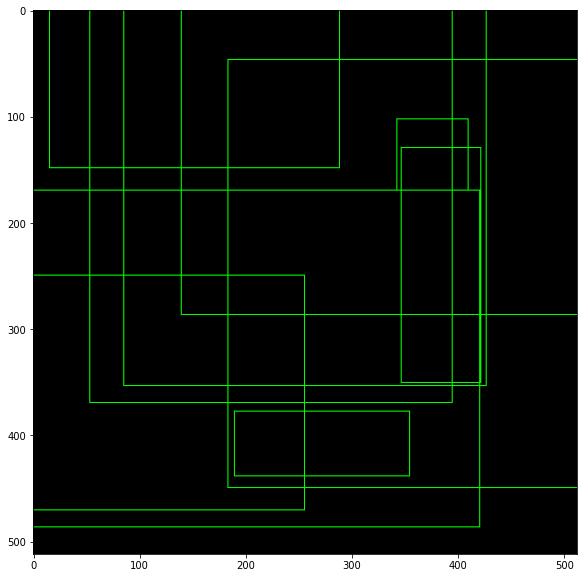

In [262]:
import random
    
    
img = np.zeros([imgSize,imgSize,3], dtype=np.uint8)
for i in range(10):
    i = random.randint(0, gridSize-1)
    j = random.randint(0, gridSize-1)
    k = random.randint(0, ancNum-1)
    b = gridAnchors[i,j,k].astype(int)
    cv2.rectangle(img, (b[0], b[1]), (b[2],b[3]), (0,255,0), 1)
plt.figure(figsize=(10,10))
plt.imshow(img);

To improve generalization, I make use of two data augmentation steps - one inside the data preparation procedure and another as part of the network - the former involves transformations that alter the ground truth box (e.g., translation), while the latter do not (e.g., brightness). The ground truth boxes are generally not given as input to the network, and so it makes more sense to perform them as part of the data preparation procedure. Additionally, since data preparation and network propagation are done in parallel, this also allows the CPU to take more load off the GPU. Now, let's define the data preparation procedure's augmentation methods (the second augmentation step will be defined in the next section)...

In [7]:
from pycocotools import mask


# this method transforms the boxes give as input, by multiplying their point coordinates by transformation matrix M.
# maxX and maxY represent the image size, and are needed to clip the boxes if they protrude out of the image
def transformBoxes(boxes, M, maxX, maxY):
    # transform the boxes' point (homogeneous) coordinates
    minMp = np.matmul(M, np.stack( # M * [xmin, ymin, 1]
        [boxes[..., 0], boxes[..., 1], np.ones(boxes.shape[:1])], axis=0))
    maxMp = np.matmul(M, np.stack( # M * [xmax, ymax, 1]
        [boxes[..., 2], boxes[..., 3], np.ones(boxes.shape[:1])], axis=0))
    return np.stack([np.clip(minMp[0, ...], 0, maxX), 
                     np.clip(minMp[1, ...], 0, maxY), 
                     np.clip(maxMp[0, ...], 0, maxX),
                     np.clip(maxMp[1, ...], 0, maxY)], axis=-1)


# this method randomly translates the image and boxes by up to t pixels 
# (in any direction)
def aug_translate(img, boxes, t=8):
    tx = random.uniform(-t, t)
    ty = random.uniform(-t, t)
    M = np.array([[1, 0, tx], [0, 1, ty]]) # translation matrix
    boxes = transformBoxes(boxes, M, img.shape[1]-1, img.shape[0]-1)
    img = cv2.warpAffine(img, M, (img.shape[1], img.shape[0])) 
    return img, boxes


# this method randomly scales the image and boxes by a factor in (1/s,s) 
# (width and height are scaled separately)
def aug_scale(img, boxes, s=1.2):
    sx = random.choice([[1/x,x] for x in [random.uniform(1,s)]][0])
    sy = random.choice([[1/x,x] for x in [random.uniform(1,s)]][0])
    c = (img.shape[1]/2, img.shape[0]/2) # the center of the image
    # scaling is done relative to the image center 
    M = np.array([[sx, 0, c[0]*(1-sx)], [0, sy, c[1]*(1-sy)]])
    boxes = transformBoxes(boxes, M, img.shape[1]-1, img.shape[0]-1)
    img = cv2.warpAffine(img, M, (img.shape[1], img.shape[0])) 
    return img, boxes


# this method flips the image and boxes horizontally  
def aug_flip_hori(img, boxes):
    img = cv2.flip(img, 1)
    xmin = img.shape[1]-1 - boxes[..., 2]
    ymin = boxes[..., 1]
    xmax = img.shape[1]-1 - boxes[..., 0]
    ymax = boxes[..., 3]
    boxes = np.stack([xmin, ymin, xmax, ymax], axis=-1)   
    return img, boxes


# this method randomly rotates the image and a box by up to r degrees.
# unlike the above methods, here we expect to receive an image concatenated with 
# a ground truth segmentation mask to rotate the box (see COCO API in [3])
def aug_rotate(img, boxes, r=15):
    r = random.uniform(-r, r)
    c = (img.shape[1]/2, img.shape[0]/2)
    M = cv2.getRotationMatrix2D((c[0], c[1]), r, 1)
    img = cv2.warpAffine(img, M, (img.shape[1], img.shape[0])) 
    seg = img[..., -1] # the segmentation mask
    # use the segmentation mask to get the rotated box
    box = mask.toBbox(mask.encode(np.asfortranarray(seg.astype(np.uint8))))
    box[2:] += box[:2] # switch to [xmin,ymin,xmax,ymax] box representation
    boxes = box[np.newaxis,...]
    return img, boxes


# this method randomly samples augmentation functions (at least 1) and 
# applies them to the received image and boxes in succession
def augment(funcs, img, boxes):
    sampledFuncs = random.sample(funcs, random.randint(1,len(funcs)))
    for f in sampledFuncs:
        img, boxes = f(img, boxes)
    return img, boxes

Mask R-CNN is basically composed of two separate networks - a region proposal network (RPN for short) that regresses the anchors (that were predicted as positive) to better fit their associated objects, and a detector network that further corrects the proposed anchors, classifies them, and finally predicts appropriate segmentation masks. In my implementation I train the two networks separately; therefore, two different data preparation procedures are needed:

The first procedure generates mini batches of padded images of size 512, as I explained, and an anchor ground truth tensor GT of shape (b,i,j,k,6) where b is the mini batch size, and i,j, and k represent anchors i,j,k (anchors k at location (i,j) on the grid). Values in GT[...,0] equal 1 for positive anchors, and 0 otherwise; GT[...,1] are similarly defined for negative anchors. Indeed, some anchors are neither positive nor negative; anchor positivity/negativity is determined by using IoU [[4](https://en.wikipedia.org/wiki/Jaccard_index)] thresholds, that is, if the IoU between a given anchor and ground truth box is greater than 0.7, the anchor is considered positive, and if the IoU is less than 0.3, the anchor is considered negative. Otherwise, the anchor is undetermined and will not contribute to the loss. In addition, every ground truth box will be associated with its best anchor (even if IoU <= 0.7) to make sure that every object has at least one anchor assigned to it. GT[...,2:6] contain the scale-invariant parameterized ground truth box coordinates as is explained in [[5](https://arxiv.org/abs/1506.01497)]. The images in this procedure are randomly augmented by translation, scaling, and horizontal flips. Now, let's define this procedure...

In [8]:
import tensorflow as tf


# pads an image with 0's so that its shape would be (imgSize, imgSize, -1)
def pad(img):
    p = np.zeros((imgSize, imgSize, img.shape[-1]))
    p[:img.shape[0], :img.shape[1]] = img
    return p


# this method is self-explanatory 
def boxArea(box):
    width = box[..., 2] - box[..., 0]
    height = box[..., 3] - box[..., 1]
    return width * height


# this method receives 2 box tensors and returns the intersection boxes and corresponding IoU values
def interBoxes(boxes1, boxes2):
    # calculate the intersection boxes
    boxes = np.stack(
        [np.maximum(boxes1[..., 0], boxes2[..., 0]), 
         np.maximum(boxes1[..., 1], boxes2[..., 1]),
         np.minimum(boxes1[..., 2], boxes2[..., 2]), 
         np.minimum(boxes1[..., 3], boxes2[..., 3])], axis=-1)
    # put to 0 illegal boxes (e.g., xmin > xmax)
    boxes *= (np.greater(boxes[..., 2], boxes[..., 0]) & 
              np.greater(boxes[..., 3], boxes[..., 1]))[..., np.newaxis]
    areas = boxArea(boxes)
    # calculate IoU
    jaccards = areas / (boxArea(boxes1) + boxArea(boxes2) - areas)
    return boxes, jaccards


# this method uses the parameterization in [5], which constitutes the box regression ground truth
def prmBoxReg(box, anc):
    ancC = 0.5 * (anc[..., :2] + anc[..., 2:]) 
    ancWH = np.stack([anc[..., 2] - anc[..., 0], 
                      anc[..., 3] - anc[..., 1]], axis=-1)
    boxC = 0.5 * (box[..., :2] + box[..., 2:])
    boxWH = np.stack([box[..., 2] - box[..., 0], 
                      box[..., 3] - box[..., 1]], axis=-1)
    txy = (boxC - ancC) / ancWH
    twh = np.log(boxWH / ancWH)
    concat = np.concatenate([txy, twh], axis=-1)
    return concat


# this dictionary is needed to access COCO training/validation metadata in real-time (i.e., during training)
cocoDict = {'train' : trainCOCO, 'val' : valCOCO}


# this is the RPN's data preparation procedure (returns a dataset).
# cocoName is used to access the training/validation COCO object (see cocoDict defined above)
def rpnPrepareDataset(cocoName, imgIds, batch_size=32):
    posThreshold=0.7 # anchor positivity IoU threshold 
    negThreshold=0.3 # anchor negativity IoU threshold
    augChance= 1.0 # the probability to augment an example (can be lowered if the CPU bottlenecks) 
    augFuncs = [aug_translate, aug_scale, aug_flip_hori] # the possible augmentation methods used by this procedure
    # this method prepares one example according to imgId
    def prepareExample(cocoName, imgId):
        cocoName = cocoName.numpy().decode('utf-8') # get the COCO object dictionary name
        coco = cocoDict[cocoName]
        imgId = [imgId.numpy()]
        imgFileName = coco.loadImgs(imgId)[0]['file_name']
        # read the image given by imgId
        img = cv2.cvtColor(cv2.imread(cocoPath+cocoName+'2017/'+imgFileName), cv2.COLOR_BGR2RGB)
        # scale the image according to the largest image dimension to maintain aspect ratio
        scale = imgSize / max(img.shape[:-1])
        scaleXY = (int(scale * img.shape[1]), int(scale * img.shape[0])) # this will be used to scale the image
        anns = coco.loadAnns(coco.getAnnIds(imgId))
        # get all 'legal' ground truth boxes in this image
        gtBoxes = np.array([a['bbox'] for a in anns if a['iscrowd'] == 0 and a['bbox'][2] * a['bbox'][3] > minBoxArea]) 
        if not len(gtBoxes): # return a dummy image and a zeroed GT (0 loss w.r.t. this example)
             return np.empty((imgSize,imgSize,3)), np.zeros(gridAnchors.shape[:-1] + (6,))
        gtBoxes[..., 2:] += gtBoxes[..., :2] # switch to [xmin,ymin,xmax,ymax] box representation
        aug = cocoName == 'train' and random.uniform(0,1) < augChance # augment training data only
        if aug:
            img, gtBoxes = augment(augFuncs, img, gtBoxes)
            legalIdx = boxArea(gtBoxes) > minBoxArea # mark all boxes that aren't too small
            if not np.sum(legalIdx): # all boxes are too small?
                # return a dummy image and a zeroed GT (0 loss w.r.t. this example)
                return np.empty((imgSize,imgSize,3)), np.zeros(gridAnchors.shape[:-1] + (6,))
            gtBoxes = gtBoxes[legalIdx]
        img = pad(cv2.resize(img, scaleXY)) # resize and pad the image
        gtBoxes *= scale # scale ground truth boxes to fit the resized and padded image
        jaccards = np.zeros(gridAnchors.shape[:-1] + (len(gtBoxes),))
        for b in range(len(gtBoxes)): # calculate IoU between anchors and ground truth box b
            jaccards[..., b] = interBoxes(gridAnchors, gtBoxes[b])[1]
        bestJaccards = np.max(jaccards, axis=-1) # get the heighest IoU for each anchor
        bestIdx = np.argmax(jaccards, axis=-1) # get the indices of the best ground truth box for each anchor 
        bestBoxes = gtBoxes[bestIdx] # get the best boxes for each anchor
        pos = (bestJaccards > posThreshold)[...,np.newaxis] # mark anchors deemed positive
        neg = (bestJaccards < negThreshold)[...,np.newaxis] # mark anchors deemed negative
        GT = np.concatenate([pos, neg, bestBoxes], axis=-1)
        # the best ground truth box for each anchor was found. Now, find the best anchor for each ground truth box
        jaccards = np.reshape(np.transpose(jaccards, (3,0,1,2)), (len(gtBoxes),-1))
        bestIdx = np.argmax(jaccards, axis=-1)[..., np.newaxis]
        s = GT.shape
        t = np.reshape(GT, (-1, 6))
        for b in range(len(gtBoxes)): # mark as positive the best anchor for box b
            t[bestIdx[b]] = 1, 0, *gtBoxes[b]
        GT = np.reshape(t, s)
        GT[..., 2:] = prmBoxReg(GT[..., 2:], gridAnchors) # use the parameterization in [5]
        return img, GT
    # I shuffle the image ids instead of the images themselves, and thus whole 
    # dataset shuffling is obtained without having to load the entire dataset into memory
    nameSet = tf.data.Dataset.from_tensor_slices(imgIds).shuffle(buffer_size=len(imgIds))
    data = nameSet.map( # a py_function is needed to access the COCO object in real-time (i.e., during training)
        lambda x: tf.py_function(prepareExample, inp=[cocoName, x], Tout=2*[tf.float32]), 
        num_parallel_calls=tf.data.AUTOTUNE)
    return tf.data.Dataset.zip(data).batch(batch_size).prefetch(tf.data.AUTOTUNE)


# create training/validation datesets
rpnTrainSet = rpnPrepareDataset('train', trainImgIds, batch_size=16)
rpnValSet = rpnPrepareDataset('val', valImgIds, batch_size=16)

INFO:tensorflow:Enabling eager execution
INFO:tensorflow:Enabling v2 tensorshape
INFO:tensorflow:Enabling resource variables
INFO:tensorflow:Enabling tensor equality
INFO:tensorflow:Enabling control flow v2


Let's check the tensor shapes generated by the above procedure (sanity check)...

In [9]:
for x in list(rpnTrainSet.take(1)):
    for x in x:
            print(x.shape)

(16, 512, 512, 3)
(16, 64, 64, 32, 6)


Great.

The second data preparation procedure also generates padded images of size 512, but this time I batch over the objects to create the ground truth, that is, each example in a mini batch represents an object in some image (a mini batch might contain the same image twice). As I explained, during training the detector takes positive anchors that need to be further corrected, classified, and segmented. In my implementation, however, the detector merely classifies and segments the objects, since the detector's box regression head is somewhat redundant provided that the RPN does a good job. 

In [[1](https://arxiv.org/abs/1703.06870)] the authors use a special operation called RoIAlign to crop evenly sized samples from a pretrained classifier network's output features according to the feature-space projection of the proposed boxes given by the RPN, which are then resized (after additional convolutions) and compared to the ground truth segmentation mask to calculate the segmentation loss (that was a mouthful and I will explain it in detail in the next section) - I found this approach a bit inconvenient to implement, and so I've decided to go in the opposite direction, that is, instead of resizing the sampled features, I 'resize' the ground truth mask by sampling it with RoIAlign as well - this way, the process does not require iterating over the boxes, and parallelization is improved to boot. To accomplish the above, the detector will receive the ground truth segmentation mask as input during training.

To summarize, the input is a tuple (img, [box], seg) where img is the image, and box and seg are the object's ground truth box and segmentation mask, respectively. The ground truth is a tuple (cls, [0]) where cls is the ground truth class of the object. Note that an axis is added to the box because RoIAlign expects a variable number of boxes, and the ground truth contains a dummy since the ground truth segmentation mask is given as input instead. The images in this procedure are randomly augmented by scaling, rotation, and horizontal flips. Now, let's define this procedure...

In [10]:
# map class id to int (0...79 instead of the original ids, which are rather arbitrary)
catIdToInt = {c['id'] : i for i, c in enumerate(cats)}

# this is the detector's data preparation procedure (returns a dataset).
# notice that this procedure receives a list of annotation ids instead of image ids 
# (each example represents an object in some image)
def detectorPrepareDataset(cocoName, annIds, batch_size=32):
    augChance = 1.0 # the probability to augment an example (can be lowered if the CPU bottlenecks) 
    augFuncs = [aug_scale, aug_rotate, aug_flip_hori] # the possible augmentation methods used by this procedure
    def prepareExample(cocoName, annId):
        cocoName = cocoName.numpy().decode('utf-8')
        coco = cocoDict[cocoName]
        annId = [annId.numpy()]
        ann = coco.loadAnns(annId)[0]
        cls = [catIdToInt[ann['category_id']]]
        box = np.array(ann['bbox'])
        box[2:] += box[:2] # switch to [xmin,ymin,xmax,ymax] box representation 
        imgFileName = coco.loadImgs(ann['image_id'])[0]['file_name']
        img = cv2.cvtColor(cv2.imread(cocoPath+cocoName+'2017/'+imgFileName), cv2.COLOR_BGR2RGB)
        seg = coco.annToMask(ann)[..., np.newaxis]
        aug = cocoName == 'train' and random.uniform(0,1) < augChance # augment training data only
        if aug:
            boxes = box[np.newaxis,...]
            # the segmentation mask is concatenated with the image so that all 
            # transformations are applied to both (I use the segmentation mask to 
            # create the ground truth box after rotation)
            imgs = np.concatenate([img, seg], axis=-1)
            imgs, boxes = augment(augFuncs, imgs, boxes)
            # if the object moves too much outside the image after augmentation, then abort the augmentation
            if boxArea(boxes) > minBoxArea:
                box = boxes[0]
                img = imgs[..., :-1]
                seg = imgs[..., -1]
        scale = imgSize / max(img.shape[:-1]) # scale the image according to the largest image dimension
        scaleXY = (int(scale * img.shape[1]), int(scale * img.shape[0]))
        img = pad(cv2.resize(img, scaleXY)) # resize and pad the image
        box *= scale # scale ground truth box to fit the resized and padded image
        seg = pad(cv2.resize(seg, scaleXY)[..., np.newaxis]) # resize and pad the segmentation mask
        return img, box, seg, cls
    # the input and ground truth are tuples, and so a helper function
    # is needed before returning the result to the dataset map function
    def helper(cocoName, annId):
        img, box, seg, cls = tf.py_function(
            prepareExample, inp=[cocoName, annId], Tout=4*[tf.float32])    
        # add an axis to box since these are used with the RoIAlign operation 
        # which expects a variable number of boxes (see RoIAlign in the next section).
        # note that a dummy is added to the ground truth, since the segmentation mask is given as input
        return (img, [box], seg), (cls, [0])
    nameSet = tf.data.Dataset.from_tensor_slices(annIds).shuffle(buffer_size=len(annIds))
    data = nameSet.map(lambda x: helper(cocoName, x), num_parallel_calls=tf.data.AUTOTUNE)
    return tf.data.Dataset.zip(data).batch(batch_size).prefetch(tf.data.AUTOTUNE)

# create training/validation datesets
detectorTrainSet = detectorPrepareDataset(
    'train', [a['id'] for a in trainAnns if 
              a['iscrowd'] == 0 and a['bbox'][2] * a['bbox'][3] > minBoxArea], batch_size=64)
detectorValSet = detectorPrepareDataset(
    'val', [a['id'] for a in valAnns if
            a['iscrowd'] == 0 and a['bbox'][2] * a['bbox'][3] > minBoxArea], batch_size=64)

Let's check the tensor shapes generated by the above procedure (sanity check)...

In [11]:
for x in list(detectorTrainSet.take(1)):
    for x in x:
        for x in x:
            print(x.shape)

(64, 512, 512, 3)
(64, 1, 4)
(64, 512, 512, 1)
(64, 1)
(64, 1)


Great.

<a id='mod'></a>
## Models 

As per [[1](https://arxiv.org/abs/1703.06870), [5](https://arxiv.org/abs/1506.01497)], both the RPN and the detector utilize transfer learning by using a pretrained classifier/encoder network to improve performance and speed up training - I use the relatively lightweight ResNet50V2 [[6](https://keras.io/api/applications/resnet/#resnet50v2-function)] as the encoder for this purpose. The authors also use a so-called 'feature pyramid network' [[7](https://arxiv.org/abs/1612.03144)] to predict anchors at different scales by using lower-level features from the encoder - this method is more accurate than using just the highest-level features, but I found it a bit cumbersome to implement and not really necessary; to make things simpler, I use a similar structure while predicting only at the final scale - this way, encoder features at different scales are still utilized by propagating information through skip connections that go from the encoder to the decoder (i.e., the part of the network that upsamples the encoder's features).

As I mentioned in the previous section, a second augmentation step is used as part of the model - this is done by the following custom layer, which performs (random) minor brightness, contrast, hue, and saturation alterations to the input images:

In [12]:
from tensorflow.keras.layers import *

# a custom image augmentation layer:
class Augment(tf.keras.layers.Layer):
    def __init__(self, name=None, **kwargs):
        super(Augment, self).__init__(name=name, **kwargs)
    def call(self, inputs, training=None): # augment during training only
        x = inputs
        if training:  
            x = tf.image.random_brightness(x, 0.2)
            x = tf.image.random_contrast(x, 0.8, 1.0)
            x = tf.image.random_hue(x, 0.1)
            x = tf.image.random_saturation(x, 0.8, 1.0)
        return x
    def get_config(self):
        config = super(Augment, self).get_config()
        config.update({})
        return config

Now that all data augmentation operations are defined, let's display some augmented images...

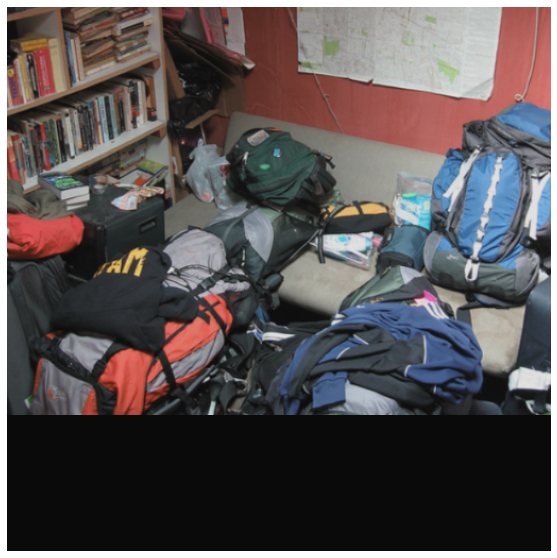

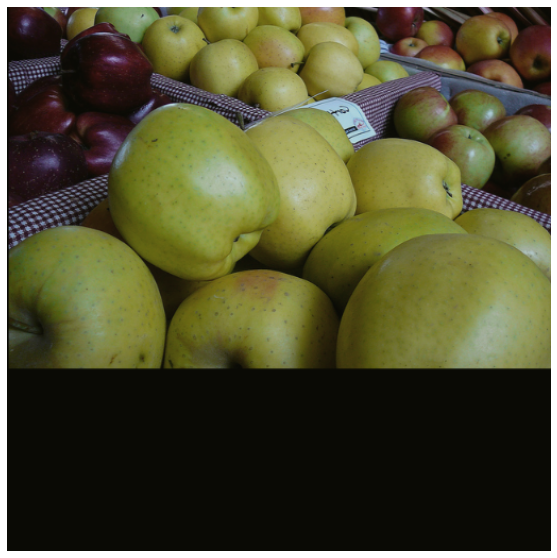

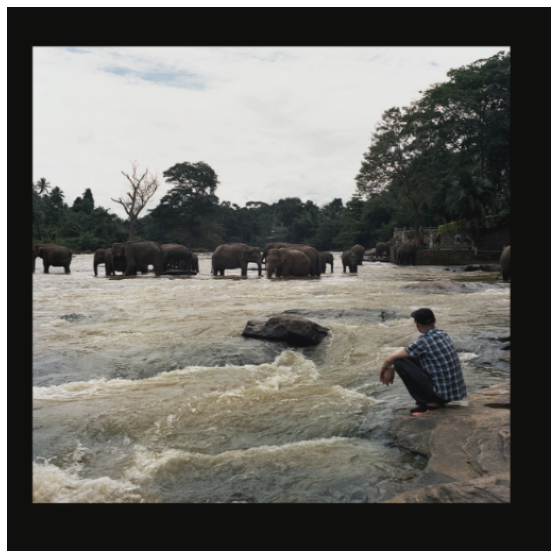

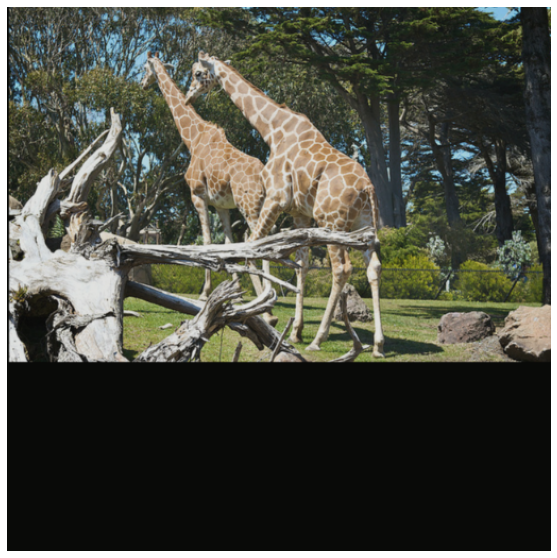

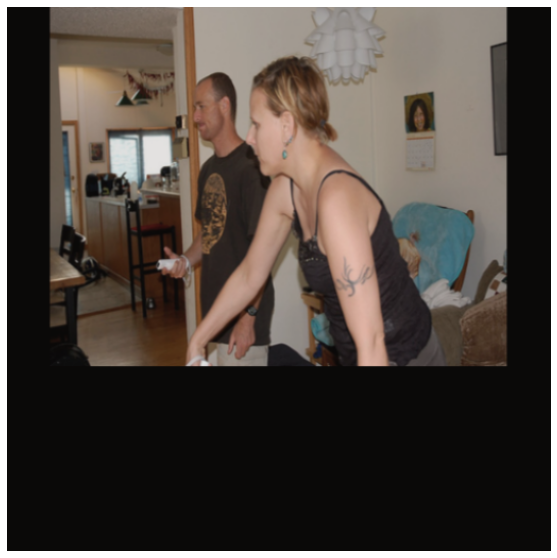

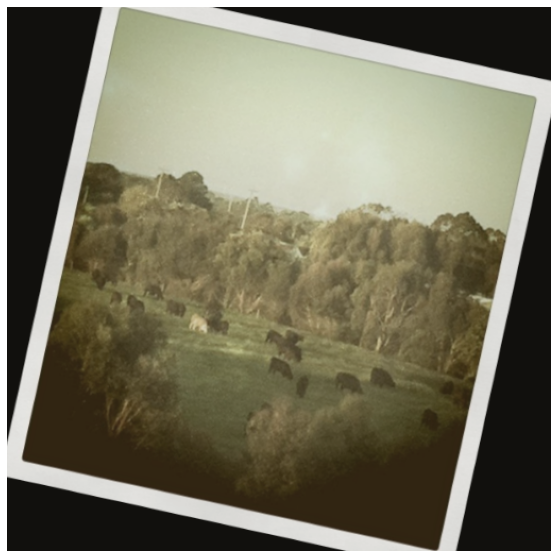

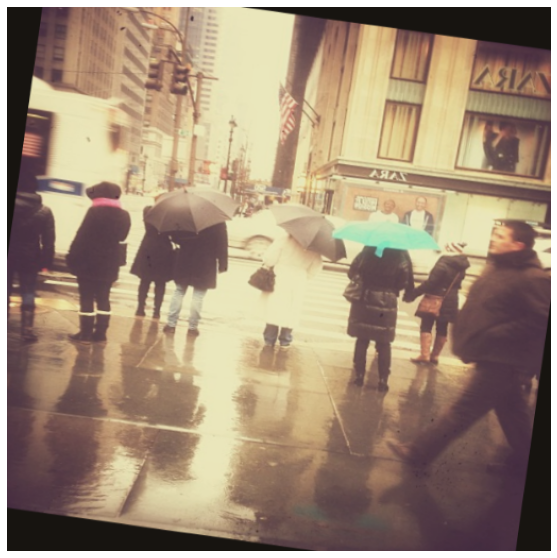

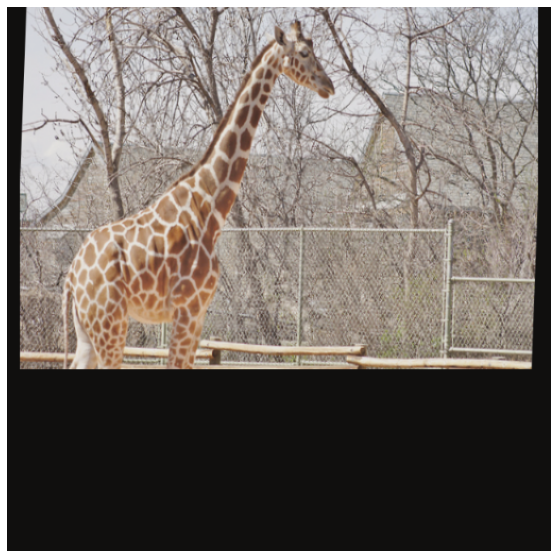

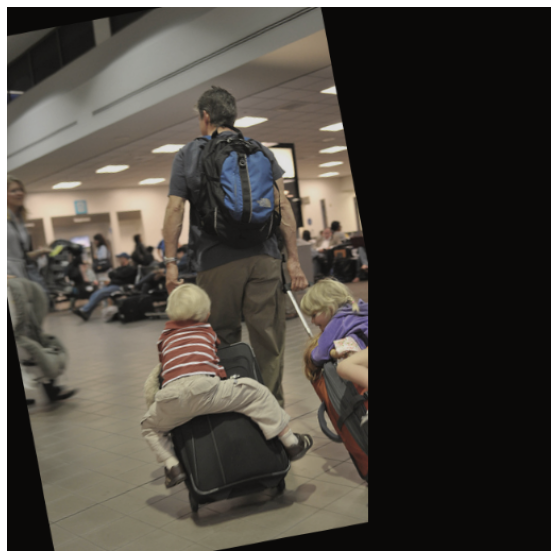

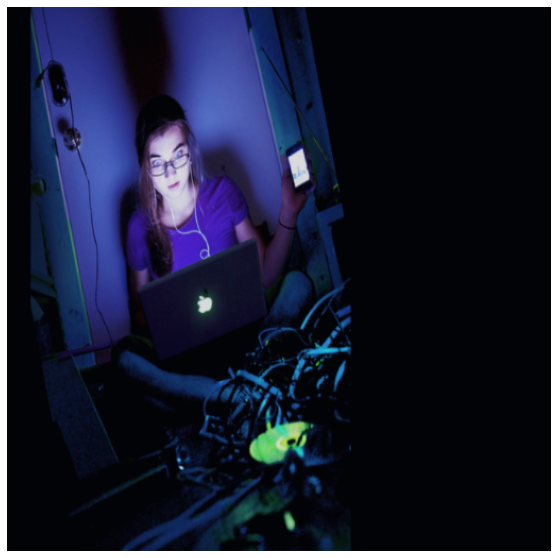

In [263]:
# augment some images by using the RPN's and the detector's data preparation procedures
imgs = tf.concat([list(rpnTrainSet.take(1))[0][0][:5], 
                  list(detectorTrainSet.take(1))[0][0][0][:5]], axis=0)
imgs = Augment()(imgs, training=True).numpy().astype(int)
for img in imgs:
    plt.figure(figsize=(10,10))
    plt.axis('off')
    plt.imshow(img)
    plt.show()

Now, let's define the encoder model...

In [14]:
from tensorflow.keras import Model

# this method creates an encoder model that's based on the ResNet50V2 classifier (see [6])
def encoder_create_model(inpSize, name):
    # the pretrained classifier
    pretrained_model = tf.keras.applications.ResNet50V2(
        include_top=False, input_shape=(inpSize,inpSize,3), weights='imagenet')
    # use features at different scales to define an encoder
    # (layer 189 has resolution NxN, layer 146 has resolution 2Nx2N, ...)
    pretrained_encoder = Model(
        inputs=pretrained_model.input,
        outputs=[pretrained_model.layers[i].output
                 for i in [189,146,78,32,2,0]], name=name+'_encoder_pretrained')
    inp = Input((inpSize,inpSize,3), name=name+'_encoder_input') # the input images
    aug = Augment(name=name+'_encoder_augment')(inp) # augment the images
    # ResNet50V2 expects preprocessed images
    prep = Lambda(
        lambda x: tf.keras.applications.resnet_v2.preprocess_input(x), name=name+'_encoder_preprocess')(aug)
    encs = pretrained_encoder(prep, training=False) # apply the encoder on the preprocessed images
    model = Model(inputs=inp, outputs=encs, name=name+'_encoder')
    return model

I use separate encoders for the RPN and the detector, since each will be fine-tuned [[14](https://www.tensorflow.org/tutorials/images/transfer_learning)] on a different kind of image data (i.e., whole images vs warped image crops) - I will expand on that when I get to the RoIAlign operation. Now, let's create an encoder for the RPN and display it...

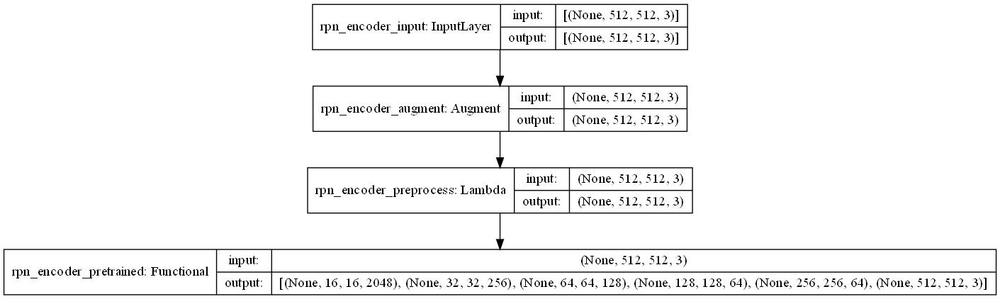

In [286]:
rpn_encoder = encoder_create_model(imgSize, 'rpn')
tf.keras.utils.plot_model(rpn_encoder, dpi=100, show_shapes=True)

Note that the encoder illustrated in the figure above has six outputs at different resolutions whose dimensions depend on the size of the input images, though only the first three are used by the RPN (the detector will use all six). The image size is 512 and the pretrained classifier downsamples five times; therefore, the resolutions of the three highest level features are 16, 32, and 64, respectively. Recall that the grid size of the RPN is 64, and so it fits the shape of third highest level feature map.

In my implementation, the main building blocks of both the RPN and the detector are the decoder blocks - these blocks apply convolutions on two input feature maps of resolutions that differ by a factor of 2 (e.g., 16 and 32), while upsampling the higher-level maps, and then adding them to the lower-level maps. To improve accuracy, I make use of residual blocks like the ones used by the pretrained classifier, but with one subtle difference - I use the more robust 'elu' [[17](https://keras.io/api/layers/activation_layers/elu/)] activation instead of 'relu' (empirically, I found 'elu' to be significantly more accurate, especially for box regression). Let's define the blocks as actual models...

In [16]:
# ResNet50V2-like residual block with 'elu' activation instead of 'relu'
def resBlock(x):
    x = inp = Input(x.shape[1:])
    x = BatchNormalization()(x)
    x = Activation('elu')(x)
    x = Conv2D(x.shape[-1], 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('elu')(x)
    x = Conv2D(x.shape[-1], 3, padding='same')(x)
    x = Lambda(lambda x: x[0] + x[1])([x, inp])
    model = Model(inp, x)
    return model


# this method upsamples features x and adds them to features y
def decoderBlock(x, y):
    h = Input(x.shape[1:]) # higher-level features
    l = Input(y.shape[1:]) # lower-level features
    y = Conv2D(y.shape[-1], 1)(l)
    y = resBlock(y)(y)
    x = Conv2D(y.shape[-1], 1)(h)
    x = resBlock(x)(x)
    x = Conv2DTranspose(y.shape[-1], 3, 2, padding='same')(x)
    x = resBlock(x)(x)
    x = Lambda(lambda x: x[0] + x[1])([x, y])
    model = Model([h,l], x)
    return model

Let's display a residual block...

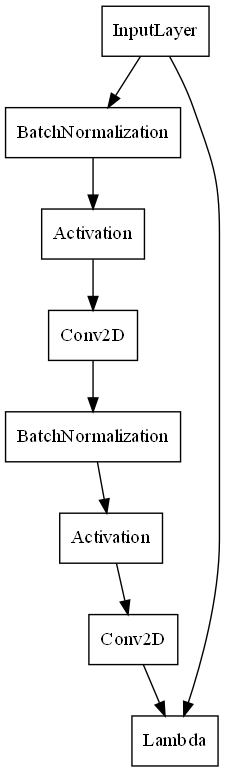

In [289]:
# display a residual block
dummy1 = np.empty([1,1,1,1])
tf.keras.utils.plot_model(resBlock(dummy1), dpi=100, show_layer_names=False)

Let's display a decoder block...

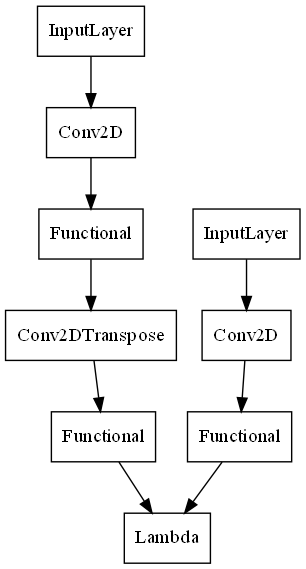

In [290]:
# display a decoder block
dummy2 = np.empty([1,2,2,1])
tf.keras.utils.plot_model(decoderBlock(dummy1, dummy2), dpi=100, show_layer_names=False)

As we can see in the above figure, my decoder blocks use residual blocks (see the 'Functional' nodes in the diagram).

The RPN has two heads connected to its encoder - one for determining 'objectness', and another for box regression - let's define them...

In [43]:
# l2 normalization along the last axis
norm = lambda x: tf.math.l2_normalize(x, axis=-1)


def rpn_obj_create_model(x):
    inp = [Input(x.shape[1:]) for x in x]
    x = inp[0]
    for p in inp[1:]:
        x = decoderBlock(x, p)([x, p])
    x = Conv2D(ancNum, 1)(x)
    x = Lambda(norm)(x)
    x = Conv2D(ancNum, 1, activation='sigmoid')(x)
    x = Lambda(lambda x: x[...,tf.newaxis])(x) # reshape [..., k] to [..., k, 1]
    model = Model(inputs=inp, outputs=x, name='obj_head')
    return model


def rpn_reg_create_model(x):
    inp = [Input(x.shape[1:]) for x in x]
    x = inp[0]
    for p in inp[1:]:
        x = decoderBlock(x, p)([x, p])
    x = Conv2D(ancNum*4, 1)(x)
    x = Lambda(norm)(x)
    x = Conv2D(ancNum*4, 1)(x) 
    x = Lambda(lambda x: tf.reshape( # reshape [..., k*4] to [..., k, 4]
        x, tf.concat([tf.shape(x)[:-1], [ancNum, 4]], axis=-1)))(x)
    model = Model(inputs=inp, outputs=x, name='reg_head')
    return model


# create the RPN's heads
rpn_obj = rpn_obj_create_model(rpn_encoder.output[:3])
rpn_reg = rpn_reg_create_model(rpn_encoder.output[:3])

Let's display the RPN's heads...

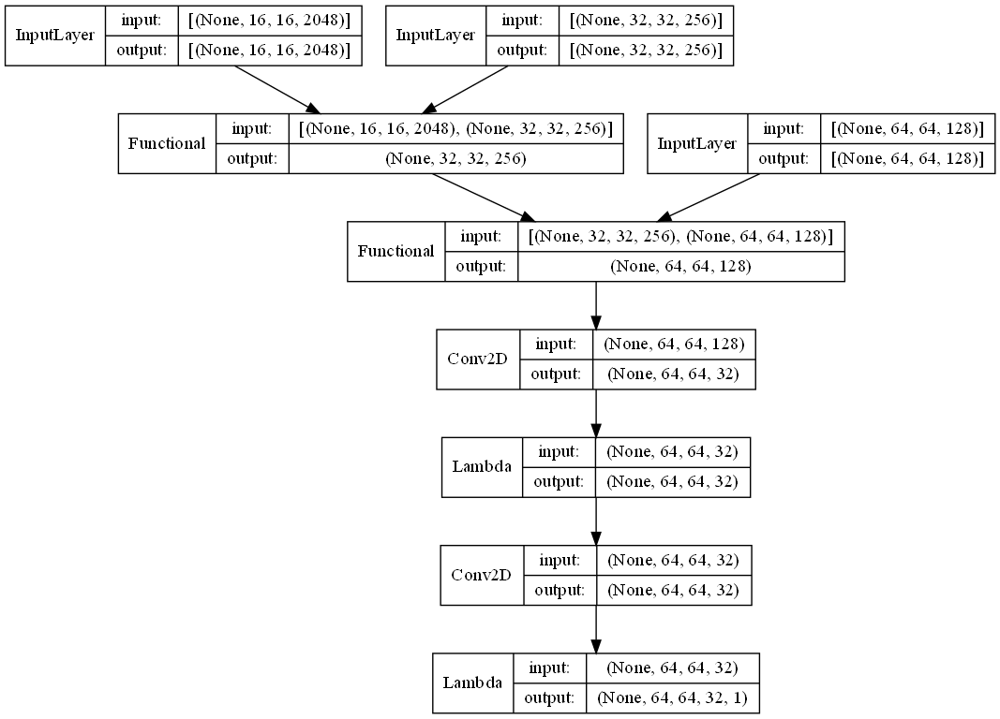

In [291]:
# display rpn_obj
tf.keras.utils.plot_model(rpn_obj, dpi=100, show_shapes=True, show_layer_names=False)

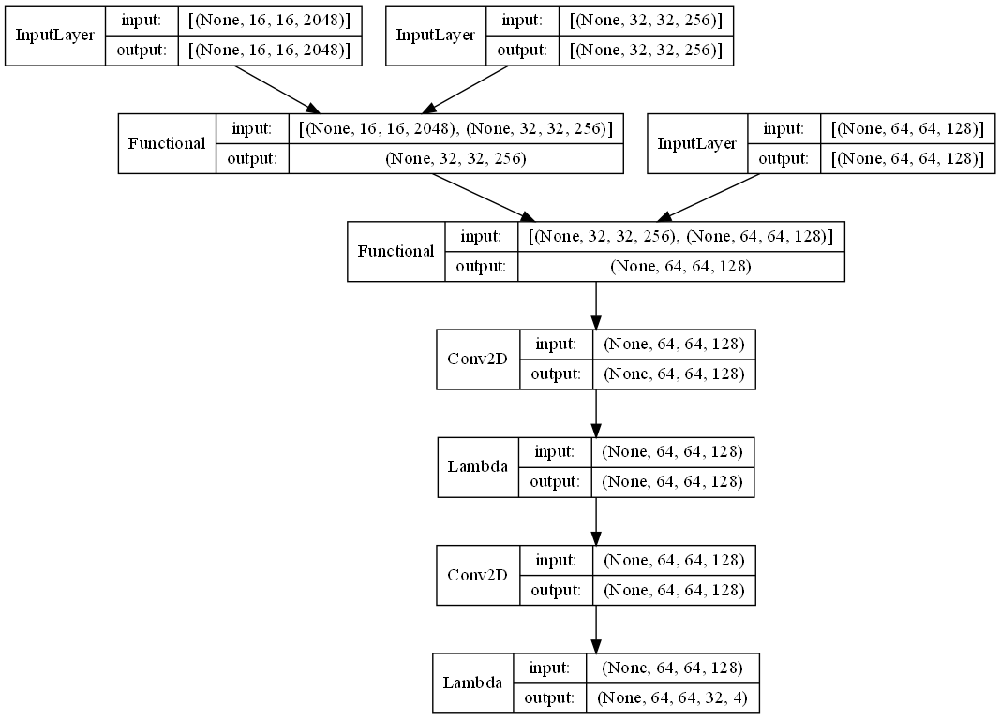

In [292]:
# display rpn_reg
tf.keras.utils.plot_model(rpn_reg, dpi=100, show_shapes=True, show_layer_names=False)

In the figure above we can see how the features are upsampled and added to features of increasingly higher resolution in a similar fashion to [[7](https://arxiv.org/abs/1612.03144)] (note that the 'Functional' nodes here are decoder blocks). I also use L2 normalization before the prediction layers to improve classification accuracy (this is inspired by [[8](https://arxiv.org/abs/1703.09507)]) and regression learning stability, since L2 normalization bounds activation values (i.e., the feature vectors along the last axis lie on the surface of a unit hypersphere).

Now, let's define and display the whole RPN model...

Model: "rpn"
________________________________________________________________________________________________________________________
Layer (type)                           Output Shape               Param #       Connected to                            
rpn_encoder_input (InputLayer)         [(None, 512, 512, 3)]      0                                                     
________________________________________________________________________________________________________________________
rpn_encoder_augment (Augment)          (None, 512, 512, 3)        0             rpn_encoder_input[0][0]                 
________________________________________________________________________________________________________________________
rpn_encoder_preprocess (Lambda)        (None, 512, 512, 3)        0             rpn_encoder_augment[0][0]               
________________________________________________________________________________________________________________________
rpn_encoder_pretrai

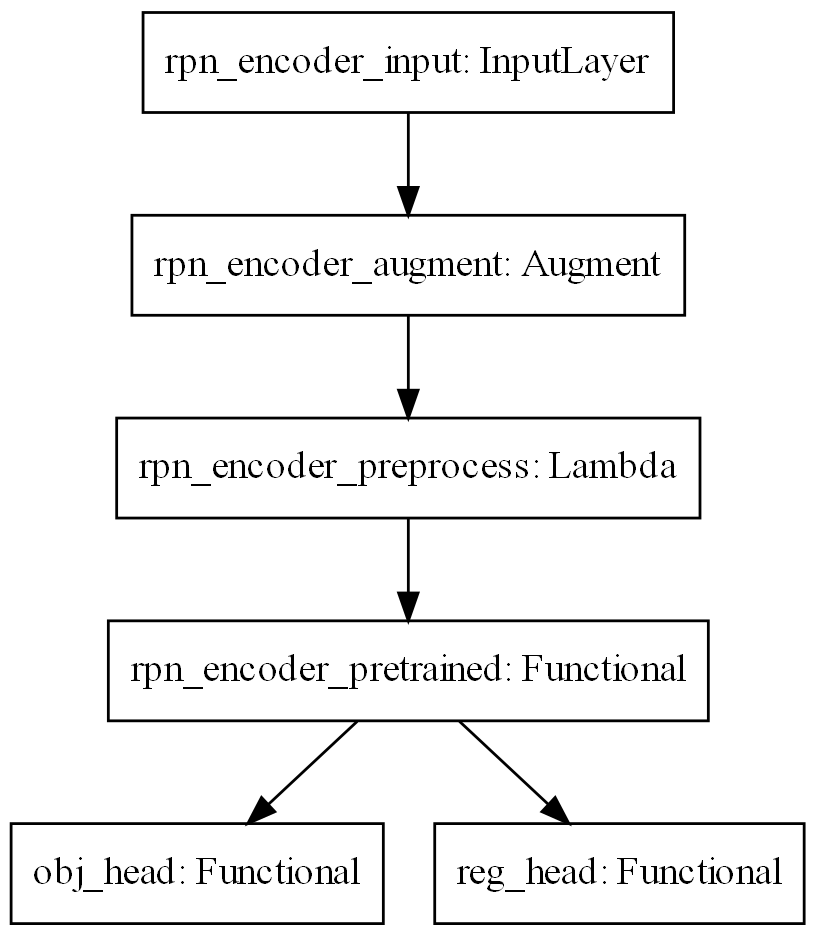

In [293]:
rpn = Model(inputs=rpn_encoder.input,
            outputs=[rpn_obj(rpn_encoder.output[:3]), rpn_reg(rpn_encoder.output[:3])], 
            name='rpn')

# display the RPN with a summary
rpn.summary(120)
tf.keras.utils.plot_model(rpn, dpi=200)

As we can see in the figure above, the two heads are connected to the RPN encoder's outputs.

The RPN proposes a lot of potential object box detections (many of which are usually false positives) that need to be pruned (mostly by non-maximum suppression [[9](https://www.tensorflow.org/api_docs/python/tf/image/combined_non_max_suppression)]) and passed on to the detector for further box refinement, classification, and segmentation. Box dimensions vary of course, and so we need some way of cropping evenly sized samples from the features according to the feature-space projection of the proposed boxes. To achieve this goal, the authors of [[1](https://arxiv.org/abs/1703.06870)] use a special operation called RoIAlign, which I already referred to in the previous section. Formally speaking, given two tensors t1 and t2 of shapes (b,i,j,c) and (b,x,4), respectively, where b is the mini batch size, (i,j,c) is the shape of the features (this can even be the images themselves as we will see), and x is the number of (pruned) boxes, we want to take evenly sized samples from t1 for each box in t2 to obtain a tensor t3 of shape (b\*x,s,s,c), representing b\*x feature crops (combining the mini batch and box dimensions is convenient as additional layers are applied on the crops). In my implementation, I take feature samples at evenly spaced points along the width and height of the box. To do that, I use a predefined normalized point sampler of size s that is transformed to fit the boxes. As per [[1](https://arxiv.org/abs/1703.06870)], the values derived from the features are calculated by bilinear interpolation.

Let's display a sampler of size s = 16, just to illustrate...

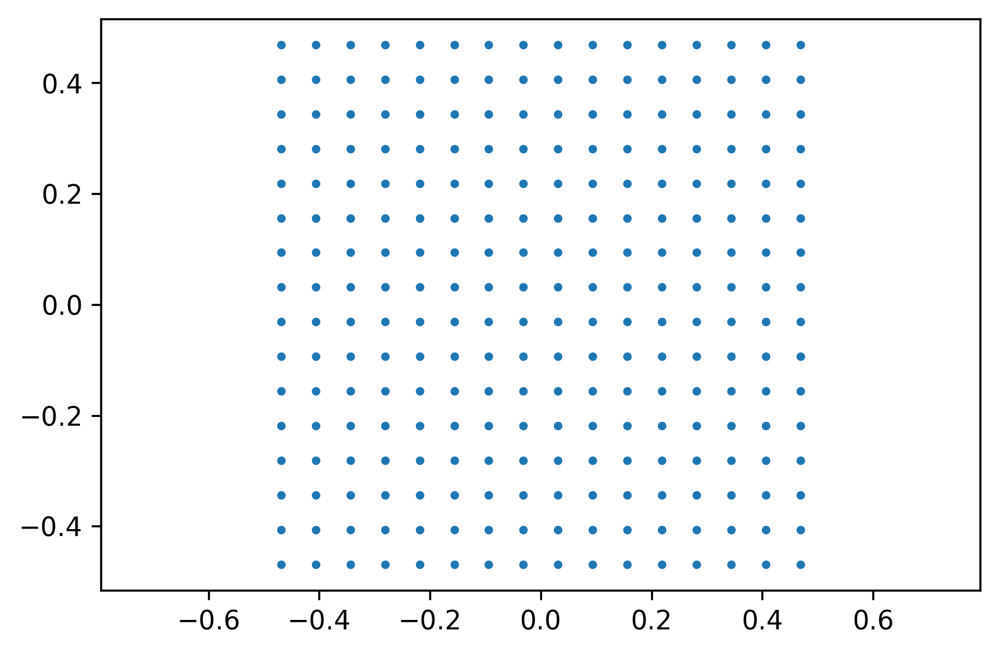

In [294]:
# this method creates a normalized sampler of size s
def createSampler(s):
    return (np.array([[i,j] for j in range(s) for i in range(s)], dtype=np.float32)-(s-1)/2)/s

p = createSampler(16)

plt.figure(dpi=300)
plt.axis('equal')
plt.scatter(p[:,0], p[:,1], s=5);

As we can see in the figure above, the sampler is composed of 16x16 evenly spaced points inside a unit square centered at the origin.

Now, let's define the RoIAlign operation as a custom layer...

In [54]:
# this custom layer receives a mini batch of features tensor of shape (b,i,j,c) and a
# feature-space projected boxes tensor of shape (b,x,4), and returns an evenly sized feature 
# samples tensor of shape (b*x,s,s,c), where s is the sampler size given as argument
class RoIAlign(tf.keras.layers.Layer):
    def __init__(self, sampleSize, name=None, **kwargs):
        super(RoIAlign, self).__init__(name=name, **kwargs)
        self.sampleSize = sampleSize
        self.samples = sampleSize**2
        self.sampler = createSampler(sampleSize)
    def call(self, inputs):
        # each box requires multiple point samples, so add an axis
        boxes = inputs[1][...,tf.newaxis,:]   
        # box centers
        c = 0.5 * (boxes[..., :2] + boxes[..., 2:])
        # widths and heights
        wh = tf.stack([boxes[..., 2] - boxes[..., 0], 
                       boxes[..., 3] - boxes[..., 1]], axis=-1) 
        batchSize = tf.shape(boxes)[0]
        # transform the sampler to fit the boxes
        transSampler = tf.reshape(self.sampler * wh + c, [batchSize,-1,2])
        f = tf.math.floor(transSampler)
        c = tf.math.ceil(transSampler)
        fx, fy, cx, cy = f[..., 0], f[..., 1], c[..., 0], c[..., 1]
        features = inputs[0]
        channels = features.shape[-1]
        featSize = tf.cast(tf.shape(features)[-2], tf.float32)
        # for each sample point, get the 4 indices that contain it
        # (e.g., (3.5,4.5) is contained by (3,4), (3,5), (4,4), (4,5)):
        idxfxfy = tf.cast(featSize * fy + fx, tf.int32)
        idxfxcy = tf.cast(featSize * cy + fx, tf.int32)
        idxcxfy = tf.cast(featSize * fy + cx, tf.int32)
        idxcxcy = tf.cast(featSize * cy + cx, tf.int32)
        # sample the features according to the indices above:
        reshapedFeatures = tf.reshape(features, [batchSize,-1,channels])
        featfxfy = tf.gather(reshapedFeatures, idxfxfy, axis=1, batch_dims=1)
        featfxcy = tf.gather(reshapedFeatures, idxfxcy, axis=1, batch_dims=1)
        featcxfy = tf.gather(reshapedFeatures, idxcxfy, axis=1, batch_dims=1)
        featcxcy = tf.gather(reshapedFeatures, idxcxcy, axis=1, batch_dims=1)
        # perform bilinear interpolation of the samples above:
        x, y = transSampler[...,0], transSampler[...,1]
        px = (x - fx)[..., tf.newaxis]
        py = (y - fy)[..., tf.newaxis]
        xu = (1 - px) * featfxfy + px * featcxfy
        xd = (1 - px) * featfxcy + px * featcxcy
        yud = (1 - py) * xu + py * xd
        return tf.reshape(yud, [-1, self.sampleSize, self.sampleSize, channels])
    def get_config(self):
        config = super(RoIAlign, self).get_config()
        config.update({"sampleSize": self.sampleSize})
        return config

Let's see if RoIAlign works by sampling from a few images (sanity check)...

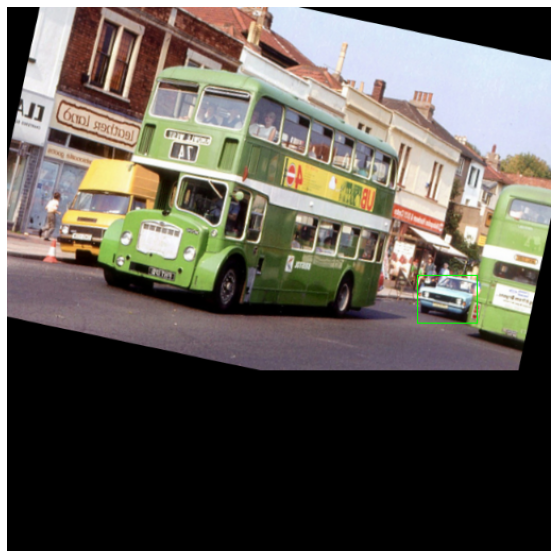

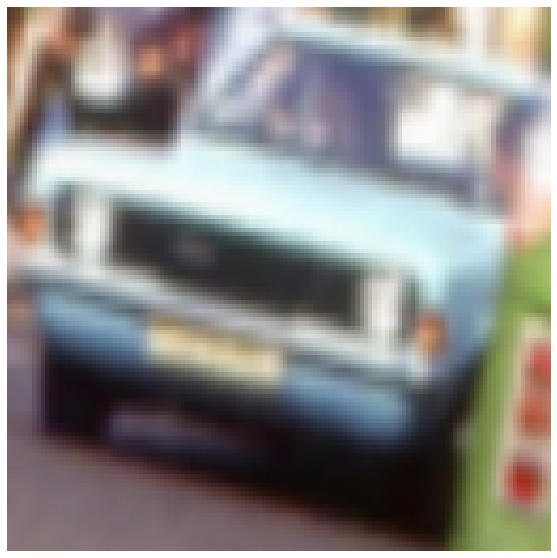

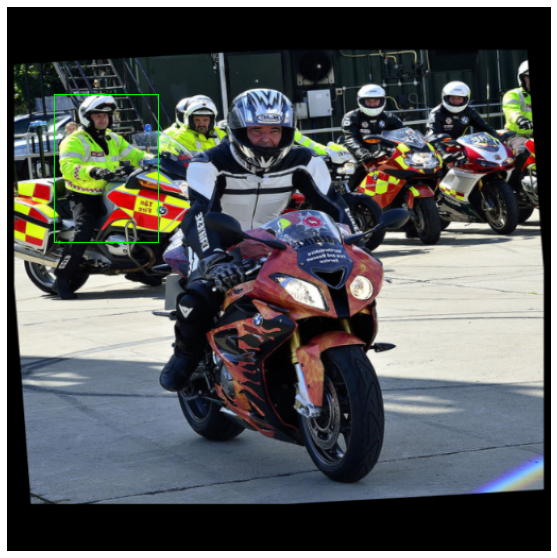

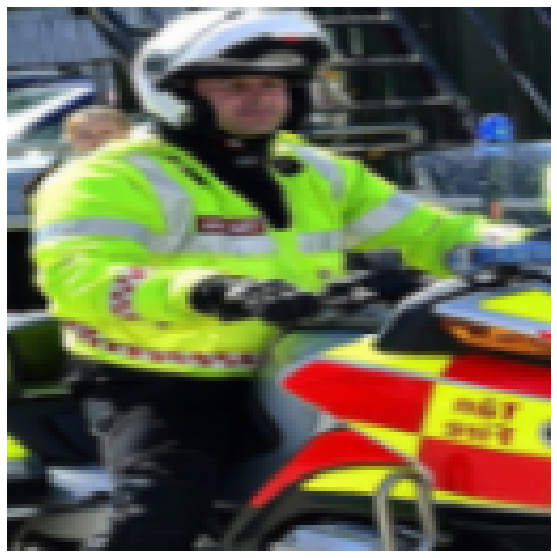

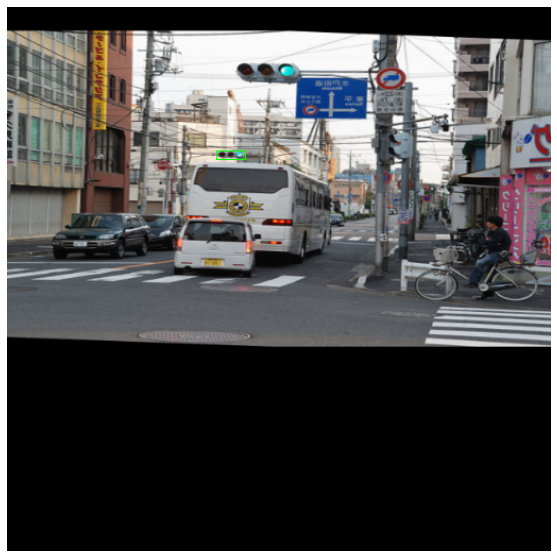

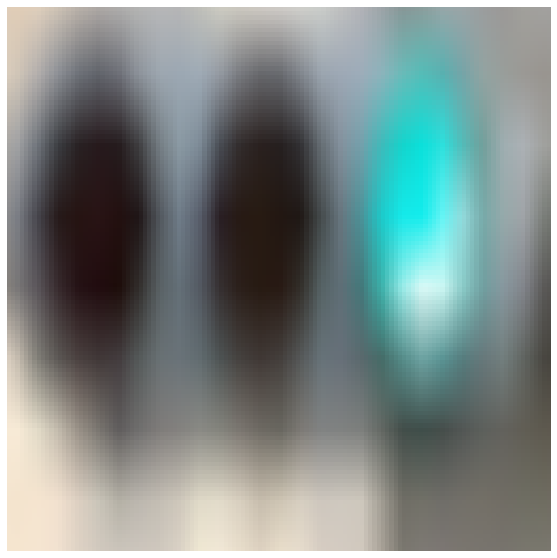

In [264]:
imgNum = 3
data = list(detectorTrainSet.take(1))
imgs = data[0][0][0][:imgNum]
boxes = data[0][0][1][:imgNum]

sampleSize = 128
# sample the images with RoIAlign according to the boxes
rois = RoIAlign(sampleSize)([imgs, boxes]).numpy().astype(int)
imgs = imgs.numpy().astype(int)
boxes = np.round(boxes).astype(int)

# display the images and their corresponding RoI samples
for i in range(imgNum):
    b = boxes[i][0]
    cv2.rectangle(imgs[i], (b[0], b[1]), (b[2],b[3]), (0,255,0),1)
    for x in [imgs[i]] + [rois[i]]:
        plt.figure(figsize=(10,10))
        plt.axis('off')
        plt.imshow(x)
        plt.show();

Great.

As I mentioned, the detector uses its own encoder which is identical to the RPN's encoder (it's possible to use a completely different one, of course), and two heads - one for classification and another for segmentation - which are applied on the sampled features derived from the RPN's box predictions only during inference; therefore, two detector models need to be defined - one for training and another for inference - the former is simpler and does not require box pruning, since it simply receives the ground truth box of the object along with its associated image. Let's first define the detector's heads and the model that will be used to train the detector...

In [231]:
# 80 classes
clsNum = len(cats)


# this method creates the detector's classification head
def detector_cls_create_model(x):
    x = roi = Input(x.shape[1:])
    x = Conv2D(clsNum, 1)(x)
    x = GlobalAvgPool2D()(x)
    x = Lambda(norm)(x)
    x = Dense(clsNum, activation='softmax')(x)
    model = Model(inputs=roi, outputs=x, name='cls_head')
    return model


# this method creates the detector's segmentation head
def detector_seg_create_model(x):
    rois = [Input(x.shape[1:]) for x in x]
    x = rois[0]
    for r in rois[1:]:
        x = decoderBlock(x, r)([x, r])
    x = Conv2D(2, 1)(x)
    x = Lambda(norm)(x)
    x = Conv2D(1, 1, activation='sigmoid')(x)
    model = Model(inputs=rois, outputs=x, name='seg_head')
    return model

The two methods defined in the above code segment create the detector's classification and segmentation heads, respectively. Let's define 'detector_train' (i.e., the model that will be used to train the detector)...

In [232]:
# the image
imgInp = Input((imgSize,imgSize,3), name='img_inp')

# the ground truth box
boxInp = Input((None,4), name='box_inp')

# the ground truth segmentation mask
segInp = Input((None,None,1), name='seg_inp')

# I take large samples from the images themselves instead of small samples from the features
sampleSize = 128

# create the detector's encoder
detector_encoder = encoder_create_model(sampleSize, 'detector')

# concatenate the image and the ground truth segmentation mask
imgSegConcat = Concatenate(name='img_seg_concat')([imgInp, segInp])

# sample the above according to the ground truth box
RoI = RoIAlign(sampleSize, name='RoI')([imgSegConcat, boxInp])

# apply the detector's encoder on the image samples
imgRoI = detector_encoder(Lambda(lambda x: x[..., :-1], name='img_RoI')(RoI))

# create the detector's classification head
detector_cls = detector_cls_create_model(imgRoI[0])

# create the detector's segmentation head
detector_seg = detector_seg_create_model(imgRoI)

# binarize the segmentation sample to produce the final ground truth
segGT = Lambda(lambda x: tf.cast(x[..., -1:] > 0.5, tf.float32), name='seg_GT_RoI')(RoI)

# apply the detector's segmentation head on the features and
# concatenate its prediction and the binarized ground truth samples
segConcat = Concatenate(name='seg_concat')([segGT, detector_seg(imgRoI)])

# apply the detector's classification head on the features and define the 'detector_train' model
detector_train = Model(inputs=[imgInp, boxInp, segInp], 
                       outputs=[detector_cls(imgRoI[0]), segConcat], 
                       name='detector_train')

Unlike the approach in [[1](https://arxiv.org/abs/1703.06870)], I sample from the images themselves instead of sampling from the features - this approach has several advantages:
- Less object-specific information is lost due to pooling operations.
- The entire encoder can be fine-tuned to better fit the (usually) warped samples.
- Error does not need to be backpropagated through the RoIAlign layer, which would be computationally intensive.
- The encoder's multi-scale output features can be easily added to their decoder counterparts - this improves segmentation accuracy by combining semantic and spatial information given by the higher and lower-level features, respectively.
- Although trivial, there is no need to project the boxes to feature-space.

Now, let's display the detector's heads...

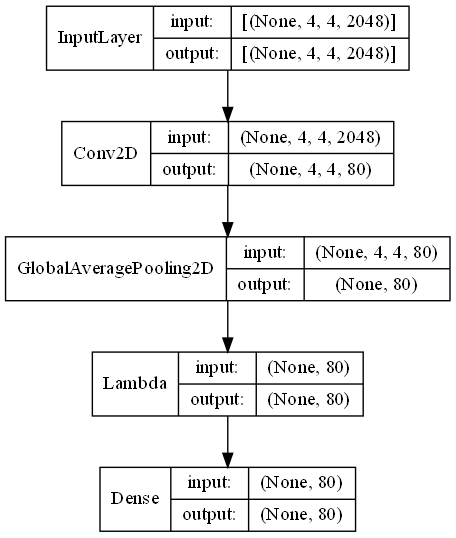

In [295]:
# display the detector's classification head
tf.keras.utils.plot_model(detector_cls, dpi=100, show_shapes=True, show_layer_names=False)

As we can see, the classification head is very simple indeed.

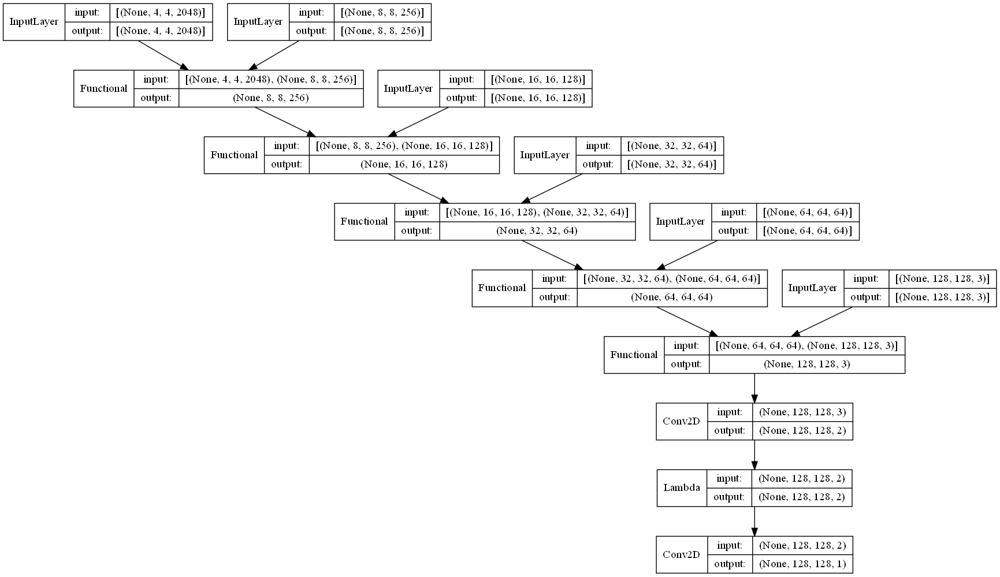

In [296]:
# display the detector's segmentation head
tf.keras.utils.plot_model(detector_seg, dpi=100, show_shapes=True, show_layer_names=False)

As we can see, I use a sampler of size 128 = 512/4 (the first input is of size 4 = 16/4) to sample from the image, and the output of the segmentation head is also 128 as I use the sixth output of the detector's encoder which is the sample itself.

The detector's heads illustrated above are relatively simple and use operations quite like the ones used by the RPN's heads (e.g., residual blocks, decoder blocks, L2 normalization, etc.). I should note that the detector used in [[1](https://arxiv.org/abs/1703.06870)] is quite different, both in terms of structure and logic. In particular, the classification head in [[1](https://arxiv.org/abs/1703.06870)] is used to select the appropriate feature channel from the prediction layer of the segmentation head as a way of decoupling classification and segmentation - this assumption is not exactly true, though, since the prediction layer's channels share features from previous layers whose weights are updated during training; ergo, 'competition' between classes still occurs. Indeed, the authors of [[1](https://arxiv.org/abs/1703.06870)] indicated that results were almost as good when using a so-called 'class-agnostic' approach like the one I've presented in the above figure (i.e., a single segmentation mask channel shared by all classes).

Let's display the detector model used for training...

Model: "detector_train"
________________________________________________________________________________________________________________________
Layer (type)                           Output Shape               Param #       Connected to                            
img_inp (InputLayer)                   [(None, 512, 512, 3)]      0                                                     
________________________________________________________________________________________________________________________
seg_inp (InputLayer)                   [(None, None, None, 1)]    0                                                     
________________________________________________________________________________________________________________________
img_seg_concat (Concatenate)           (None, 512, 512, 4)        0             img_inp[0][0]                           
                                                                                seg_inp[0][0]                           
________

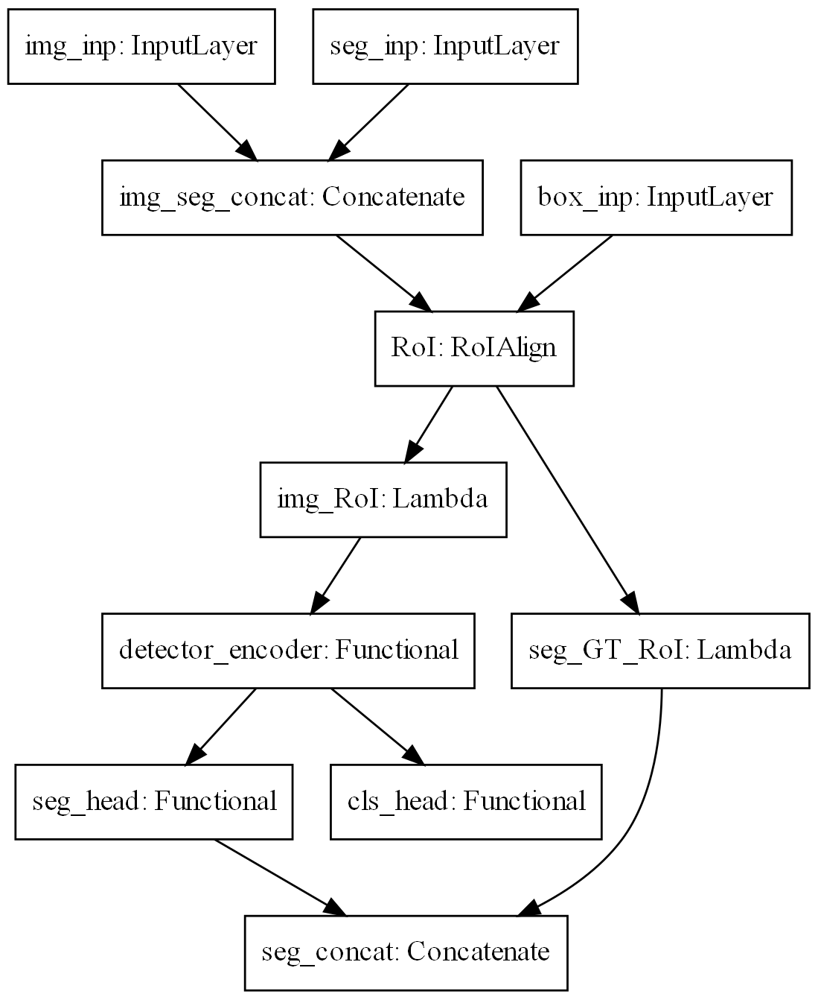

In [297]:
# display the detector model used for training
detector_train.summary(line_length=120)
tf.keras.utils.plot_model(detector_train, dpi=200)

The 'detector_train' model illustrated in the above figure operates as follows:

1. 'img_seg_concat' concatenates 'img_inp' (i.e., the input image) and 'seg_inp' (i.e., the input ground truth segmentation mask).
2. 'RoI' samples the output produced by 'img_seg_concat' according to 'box_inp' (i.e., the input ground truth box).
3. 'detector_encoder' (i.e., the detector's encoder) is applied on 'img_RoI' (i.e., the image samples).
4. 'seg_head' (i.e., the detector's segmentation head) and 'cls_head' (i.e., the detector's classification head) are applied on the output produced by 'detector_encoder'.
5. 'seg_GT_RoI' binarizes the ground truth segmentation mask samples.
6. 'seg_concat' concatenates 'seg_GT_RoI' and  the segmentation prediction given by 'seg_head' to produce 'seg_concat' ('cls_head' and 'seg_concat' constitute the output of the model).

A few things worth emphasizing:
- The detector's encoder augments and preprocesses the image samples, not the image itself.
- The input image and ground truth segmentation mask are concatenated at the beginning so that RoIAlign can sample both simultaneously.
- The model outputs both the segmentation prediction and its associated ground truth samples so that the segmentation loss can be calculated.

Finally, let's define the detector model that will be used for inference...

In [270]:
# this method transforms the box regression predictions into boxes
# (i.e., the inverse of the prmBoxReg method defined in the previous section)
def inversePrmBoxReg(prms, ancs):
    ancC = 0.5 * (ancs[..., :2] + ancs[..., 2:])
    ancWH = tf.stack([ancs[..., 2] - ancs[..., 0],
                      ancs[..., 3] - ancs[..., 1]], axis=-1)
    txy = prms[..., :2] 
    twh = prms[..., 2:]    
    boxC = txy * ancWH + ancC
    boxWH = ancWH * tf.math.exp(twh)
    pmin = boxC - 0.5 * boxWH
    pmax = boxC + 0.5 * boxWH
    concat = tf.concat([pmin,pmax], axis=-1)
    clip = tf.clip_by_value(concat, 0, imgSize-1)
    return clip


# apply the RPN on the image
rpnOutput = rpn(imgInp)

# transform the RPN's predictions into boxes
# (gridAnchors is repeated to fit the batch size)
rpn_boxes = Lambda(
    lambda x: inversePrmBoxReg(x[0], tf.repeat(
        gridAnchors[tf.newaxis,...], tf.shape(x)[0], axis=0)), name='rpn_boxes'
)(rpnOutput[1])

# select the top k = 2 anchor 'objectness' scores at each location on the grid
# (this prunes anchors at every location before using non-maximum suppression)
k = 2
loc_pruned_scores, idx = Lambda(
    lambda x: tf.math.top_k(x[..., 0], k=k), name='loc_scores'
)(rpnOutput[0])
# select the top k boxes at each location according to the above indices
loc_pruned_boxes = Lambda(
    lambda x: tf.gather(x[0], x[1], axis=-2, batch_dims=-1), name='loc_boxes'
)([rpn_boxes, idx])

# use non-maximum suppression on the remaining boxes
boxNum = 64
iouThresh = 0.3
nmsBoxes, nmsScores, _, _ = Lambda(
    lambda x: tf.image.combined_non_max_suppression(
        tf.reshape(x[0], [tf.shape(x[0])[0],-1,1,4]),
        tf.reshape(x[1], [tf.shape(x[1])[0],-1,1]),
        max_output_size_per_class=boxNum,
        max_total_size=boxNum,
        iou_threshold=iouThresh,
        clip_boxes=False), name='nms'
)([loc_pruned_boxes, loc_pruned_scores])

# sample the image according to the above boxes
RoI = RoIAlign(sampleSize, name='RoI')([imgInp, nmsBoxes])

# apply the detector's encoder on the above samples to produce features
imgRoI = detector_encoder(RoI)
    
# apply the detector's classification head on the above features to 
# produce P(C=c|O=True) (i.e., the probabilities that the objects 
# detected by the boxes belong to classes c), and multiply them by
# P(O=True) (i.e., the probabilities that the selected boxes detected objects), given 
# by the above non-maximum suppression, to obtain P(O=True,C=c) (i.e., the
# probabilities that the boxes detected objects of classes c)
jointScores = Lambda(
    lambda x: x[0][..., tf.newaxis] * tf.reshape(x[1], [-1,boxNum,clsNum]), name='joint_scores'
)([nmsScores, detector_cls(imgRoI[0])])

# apply the detector's segmentation head on the features, 
# and output the result along with the above boxes and scores
output = Lambda(
    lambda x: [x[0], x[1], tf.reshape(x[2], [-1,boxNum,sampleSize,sampleSize])], name='output'
)([nmsBoxes, jointScores, detector_seg(imgRoI)])

# define the detector model that will be used for inference
detector_infer = Model(inputs=imgInp, outputs=output, name='detector_infer')

Let's display the model defined in the above code segment, and then follow up with an elaborate explanation...

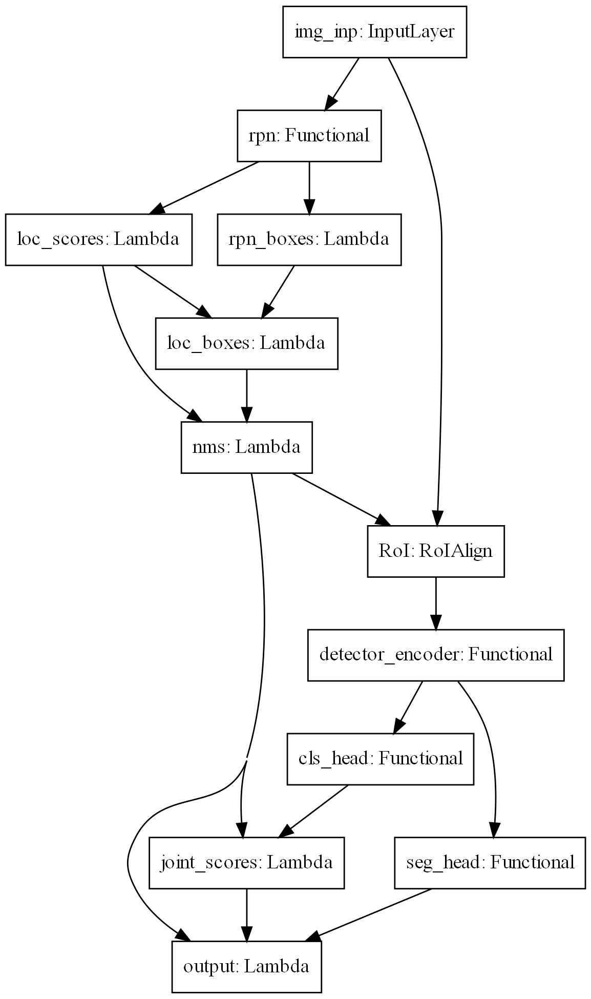

In [298]:
# display the detector model used for inference
tf.keras.utils.plot_model(detector_infer, dpi=200)

The 'detector_infer' model illustrated in the above figure operates as follows:
1. 'rpn' (i.e., the trained RPN model) is applied on 'img_inp' to produce the score P(O=True) (i.e., the probabilities that the grid anchors detected objects) and box regression predictions.
2. 'loc_scores' selects the top 2 scores at each location on the grid predicted by the RPN's 'objectness' head in step 1.
3. The indices output by 'loc_scores' are used to select the appropriate boxes in 'rpn_boxes' (i.e., the boxes inferred by the parameterized predictions given by the RPN's box regression head in step 1).
4. The selected boxes and scores output by 'loc_boxes' and 'loc_scores', respectively, are further pruned by 'nms' (i.e., non-maximum suppression) and the top 64 boxes are selected.
5. 'RoI' samples 'img_inp' according to the boxes output by 'nms'.
6. 'detector_encoder' is applied on the above samples to produce features.
7. 'cls_head' (i.e., the trained detector's classification head) and 'seg_head' (i.e., the trained detector's segmentation head) are applied on the above features to produce the scores P(C=c|O=True) (i.e., the probabilities that the objects detected by the selected boxes belong to classes c) and segmentation predictions, respectively.
8. 'joint_scores' multiplies P(C=c|O=True) by the scores output by 'nms' to produce P(O=True,C=c) (i.e., the probabilities that the selected boxes detected objects of classes c).
9. The segmentation predictions, along with the boxes and scores produced by 'nms' and 'joint_scores', respectively, are combined to produce 'output' (i.e., the output of the model).

Note that step 3 helps prevent false positives that might slip through 'nms' in step 4, as it does not depend on IoU thresholds; recall that the 32 different anchors were intentionally chosen to be dissimilar to capture as much of the box variation in the training data as possible. As a bonus, the number of boxes given as input to 'nms' is reduced by a factor of 16 = 32/2 - this greatly reduces the running time and memory consumption of the computationally intensive 'nms'. Also, keep in mind that having more than two objects located at the exact same spot (i.e., on a 64x64 grid covering a 512x512 image) is very unlikely, and so there is little concern that the step 3 would result in a significant number of false negatives.

I should reiterate that the RPN's 'objectness' head outputs P(O), whereas the detector's classification head outputs P(C|O), that is, the latter does not learn to distinguish between objects and background. By taking the product, however, we get P(O)P(C|O) = P(O,C), which is exactly what we need in terms of classification. It is not completely clear whether the authors of [[1](https://arxiv.org/abs/1703.06870)] use a similar approach, or simply treat the RPN as no more than a coarse 'sieve' that leaves most of the work to the detector.

<a id='lea'></a>
## Learning 

As I explained in the previous sections, the RPN and the detector are trained separately. Let's start with the RPN by first defining the necessary loss functions and metrics that will be used to train and measure its performance, respectively...

In [18]:
eps = 1e-16 # prevents division by zero


# the RPN's loss functions:

# this method calculates the loss of the RPN's 'objectness' head
def obj_loss(y_true, y_pred):
    p = 1 # positive anchor loss hyperparameter
    n = 1000 # negative anchor loss hyperparameter
    pos_true = y_true[..., 0] # positive anchor mask
    neg_true = y_true[..., 1] # negative anchor mask
    pos_pred = y_pred
    neg_pred = 1-y_pred
    # this helper method calculates a balanced log loss w.r.t. the different 
    # anchor types by calculating the loss for each anchor type separately
    def ancLoss(t, p):
        # sum the anchor mask along all but the last axis
        sumTrue = tf.reduce_sum(t, axis=[0,1,2])[...,tf.newaxis]
        # calculate the log loss (the log is squared to put focus on harder anchors)
        # for each anchor type by summing along all but the last axis
        loss = tf.reduce_sum(
            t[..., tf.newaxis] * tf.math.log(p)**2, axis=[0,1,2]) / (sumTrue + eps)
        return loss
    posLoss = ancLoss(pos_true, pos_pred)
    negLoss = ancLoss(neg_true, neg_pred)
    loss = p * posLoss + n * negLoss
    return loss


# this method calculates the loss of the RPN's box regression head
def reg_loss(y_true, y_pred):
    r = 100 # loss hyperparameter
    pos_true = y_true[..., 0] # the loss will be divided by the number of positive anchors
    reg_true = y_true[..., 2:] # the parameterized box regression ground truth values
    # like the 'objectness' loss, calculate a balanced
    # loss w.r.t. the different anchor types by summing along all but the last axis
    sumPos = tf.reduce_sum(pos_true, axis=[0,1,2])
    # note that only positive anchors contribute to the loss
    loss = r * tf.reduce_sum( # I use ln(|x|+1), where x is the difference between the prediction and the ground truth
        pos_true * tf.reduce_mean(tf.math.log(tf.abs(reg_true-y_pred) + 1), axis=-1), axis=[0,1,2]) / (sumPos + eps)
    return loss



# the RPN's metrics:

# this method measures the RPN's sensitivity to positive anchors
def sen(y_true, y_pred):
    pos_true = y_true[..., 0]
    pos_pred = tf.cast(tf.greater(y_pred, 0.5), tf.float32) 
    P = tf.reduce_sum(pos_true)
    TP = tf.reduce_sum(pos_pred * pos_true[..., tf.newaxis])
    return (TP + eps) / (P + eps)


# this method measures the precision of the model w.r.t. positive anchors
def pre(y_true, y_pred):
    pos_true = y_true[..., 0]
    neg_true = y_true[..., 1]
    pos_pred = tf.cast(tf.greater(y_pred, 0.5), tf.float32)
    TP = tf.reduce_sum(pos_pred * pos_true[..., tf.newaxis])
    FP = tf.reduce_sum(pos_pred * neg_true[..., tf.newaxis])
    return (TP + eps) / (TP + FP + eps)


# this method calculates the mean squared error between the parameterized
# box regression ground truth values and the their corresponding predictions
def mse(y_true, y_pred):
    pos_true = y_true[..., 0]
    reg_true = y_true[..., 2:]
    return tf.reduce_sum(pos_true[..., tf.newaxis] * 
                         tf.square(reg_true - y_pred)) / (tf.reduce_sum(pos_true) + eps)


# note that TensorFlow calculates the mean of the returned tensors by default

The RPN has two outputs - 'objectness' scores and box regression predictions - and so two loss functions are defined in the above code segment; these loss functions are non-standard, though, so I'll explain them in detail.
The 'objectness' loss is based on the standard binary cross entropy loss [[10](https://www.tensorflow.org/api_docs/python/tf/keras/losses/BinaryCrossentropy)] with a few special nuances:
- Undetermined anchors (i.e., neither positive nor negative) do not contribute to the loss.
- I calculate log^2(p) instead of -log(p), where p is the prediction, to force the network to pay less/more attention to easy/hard anchors (e.g., clear background/occluded objects), respectively - this is my simplified version of 'focal loss' [[11](https://arxiv.org/abs/1708.02002)], which I found to work better.
- Unlike the implementation described in [[5](https://arxiv.org/abs/1506.01497)] which randomly samples an equal number of positive and negative anchors, my RPN calculates the loss with respect to all the anchors. Although there is a massive imbalance between positive and negative anchors (~3-5 orders of magnitude), this approach lets the RPN learn from a very rich distribution of positive/negative anchors on each iteration. To deal with the imbalance, I simply divide the positive/negative losses by their corresponding number of anchors. Still, I use a hyperparameter to give negative anchors a lot more weight as otherwise the detector would be overwhelmed by false positives.
- There is yet another balance related issue which has to do with the fact that some boxes usually have a lot more anchors assigned to them, and so the RPN would bias in favor of specific anchor types. For example, 'moving' a large positive anchor by a few grid-size steps would still result in a good match (versus 'moving' a small positive anchor which would usually result in a negative anchor). To deal with this, I calculate the loss for each anchor type separately by summing along all but the last axis (see the above code segment) - this way, the RPN would pay equal attention to each anchor type regardless of how many positives/negatives are associated with it in the mini batch.

The authors of [[1](https://arxiv.org/abs/1703.06870), [5](https://arxiv.org/abs/1506.01497)] use Huber loss [[18](https://www.tensorflow.org/api_docs/python/tf/keras/losses/Huber)] for box regression - although this loss function combines the stability (i.e., easier convergence) of MSE [[19](https://www.tensorflow.org/api_docs/python/tf/keras/losses/MeanSquaredError)] and the robustness (i.e., insensitivity to large values) of MAE [[20](https://www.tensorflow.org/api_docs/python/tf/keras/losses/MeanAbsoluteError)], it still isn't ideal for box regression where we want to minimize the distance between the prediction and the ground truth (unlike classification, for instance, where we only care about the network's ability to 'separate' the different classes by using a threshold). After considering the above, I came up with the idea of using the function [ln(|x| + 1)](https://www.desmos.com/calculator/lf0fgevrlv) (click on the link to display the function and its derivative), where x is the difference between the prediction and the ground truth. The function has two advantages:
- It is far more robust than any of the other regression loss functions due to the logarithmic function.
- It is more stable than MAE since it's derivative gradually increases/decreases to +/-1 as x approaches 0, rather than being constant everywhere.

By multiplying the loss by a large hyperparameter, the above advantages synergize to push the distance to 0. Empirically, I observed a reduction of about 15% of the average distance that I managed to achieve by using Huber loss - this is particularly significant as the predicted boxes indirectly influence the accuracy of classification and, even more so, segmentation. Note that this loss is calculated only for positive anchors, while also using the same idea that I described regarding the 'objectness' loss to balance the loss contributions of the different anchor types.

To measure the performance of the RPN during training, I use standard sensitivity and precision metrics for the 'objectness' (binarized) predictions, and the MSE metric for the box regression predictions.

Now that the RPN model and its loss functions are defined, we can finally compile and train it. I use the same training procedure to train the RPN and the detector, which is defined in the function 'train' in the next code segment. The procedure performs the following training steps in succession:
1. Adam optimizer [[15](https://keras.io/api/optimizers/adam/)] is used, while the pretrained classifier is 'frozen' to serve as a feature extractor [[14](https://www.tensorflow.org/tutorials/images/transfer_learning)].
2. The pretrained classifier is 'thawed' and training switches to fine-tuning using SGD [[16](https://keras.io/api/optimizers/sgd/)] with momentum.
3. The learning rate is decreased (from 0.001 to 0.0001), and training continues until early stopping [[21](https://keras.io/api/callbacks/early_stopping/)] is triggered.

Adam optimizer is fast but tends to generalize poorly [[12](https://arxiv.org/abs/1705.08292)]; therefore, it is used in the first step to get the trainable parameters to a good 'position' quickly. The next two steps are like the training procedure used in [[5](https://arxiv.org/abs/1506.01497)]. Note that each of the above steps is terminated by early stopping.

In [39]:
# this method trains a model in three steps:
# 1. Adam optimizer is used, while the pretrained classifier is 'frozen' to serve as a feature extractor.
# 2. The pretrained classifier is 'thawed' and training switches to fine-tuning using SGD with momentum.
# 3. The learning rate is decreased (from 0.001 to 0.0001), and training continues until early stopping is triggered.
# variable min_delta of EarlyStopping implicitly determines when to switch to the next step
def train(model, pretrained, trainSet, valSet, losses, metrics):
    print("\nTraining on extracted features using Adam...\n")
    pretrained.trainable = False
    model.compile(loss=losses, metrics=metrics, optimizer=tf.keras.optimizers.Adam())
    h1 = model.fit(x=trainSet, validation_data=valSet, epochs=10,
                   callbacks=tf.keras.callbacks.EarlyStopping(min_delta=0.1, patience=1)).history
    print("\nSwitching to fine-tuning with SGD...\n")
    pretrained.trainable = True
    model.compile(loss=losses, metrics=metrics,
                  optimizer=tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9))
    h2 = model.fit(x=trainSet, validation_data=valSet, epochs=10,
                   callbacks=tf.keras.callbacks.EarlyStopping(min_delta=0.01, patience=1)).history
    print("\nDecreasing the learning rate...\n")
    model.compile(loss=losses, metrics=metrics,
                optimizer=tf.keras.optimizers.SGD(learning_rate=0.0001, momentum=0.9))
    h3 = model.fit(x=trainSet, validation_data=valSet, epochs=10,
                   callbacks=tf.keras.callbacks.EarlyStopping(min_delta=0.001, patience=1)).history
    h = {k : h1[k] + h2[k] + h3[k] for k in h1.keys()} # merge histories
    return h

Let's train the RPN...

In [47]:
# train the RPN
h = train(rpn, 
          rpn_encoder.get_layer('rpn_encoder_pretrained'), 
          rpnTrainSet, 
          rpnValSet,
          losses=[obj_loss, reg_loss], 
          metrics=[[sen, pre], [mse]])


Training on extracted features using Adam...

Epoch 1/10
7393/7393 [==============================] - 4061s 548ms/step - loss: 44.9137 - obj_head_loss: 37.7084 - reg_head_loss: 7.2053 - obj_head_sen: 0.0094 - obj_head_pre: 0.9654 - reg_head_mse: 0.0448 - val_loss: 9.0839 - val_obj_head_loss: 3.0195 - val_reg_head_loss: 6.0644 - val_obj_head_sen: 0.3167 - val_obj_head_pre: 0.9279 - val_reg_head_mse: 0.0321
Epoch 2/10
7393/7393 [==============================] - 4045s 547ms/step - loss: 8.7623 - obj_head_loss: 2.7372 - reg_head_loss: 6.0251 - obj_head_sen: 0.3717 - obj_head_pre: 0.9120 - reg_head_mse: 0.0313 - val_loss: 8.2987 - val_obj_head_loss: 2.4902 - val_reg_head_loss: 5.8085 - val_obj_head_sen: 0.4609 - val_obj_head_pre: 0.8640 - val_reg_head_mse: 0.0297
Epoch 3/10
7393/7393 [==============================] - 4046s 547ms/step - loss: 8.1013 - obj_head_loss: 2.3203 - reg_head_loss: 5.7810 - obj_head_sen: 0.5197 - obj_head_pre: 0.8841 - reg_head_mse: 0.0292 - val_loss: 8.0692 - val

On the one hand, we can see that the precision is quite high, and so the RPN should be able to get rid of most of the negative anchors (also recall that multiple box-pruning steps will be applied on the RPN's output by the detector). on the other hand, the sensitivity doesn't seem very impressive - this is misleading, though, as most objects usually have more than a single anchor assigned to them, and we only need to detect one per object. Note that the MSE result is strongly dependent on the predetermined anchors as they were chosen, a priori, to match the expected ground truth boxes in the data, and so it is a bit hard to interpret at this point; suffice to say that there is gradual improvement during training.

Let's display the entire training history to get a clearer picture of the training progress...

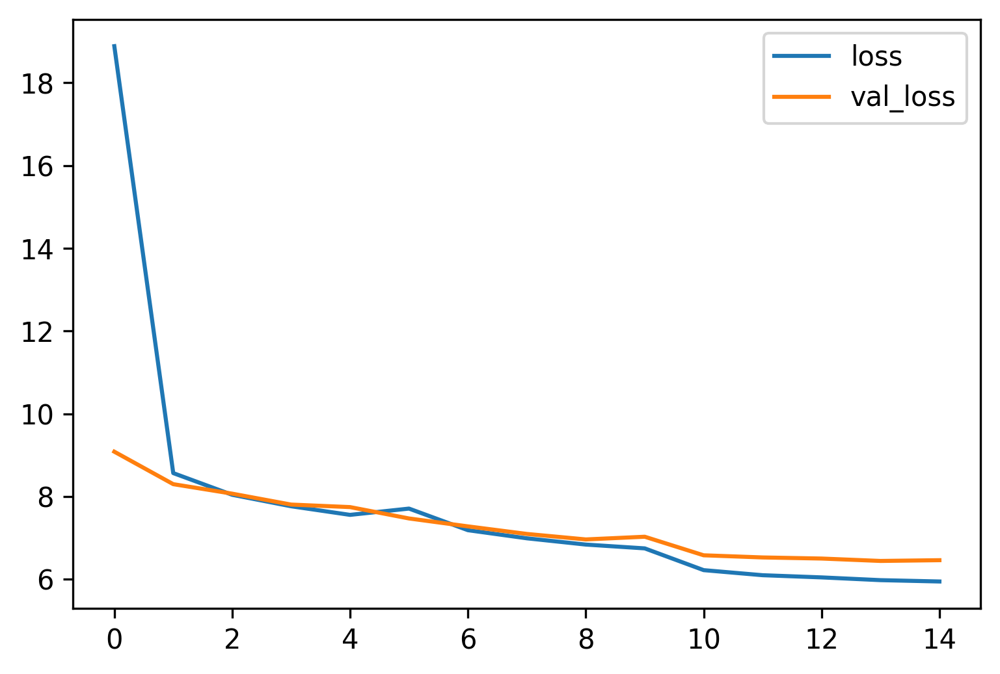

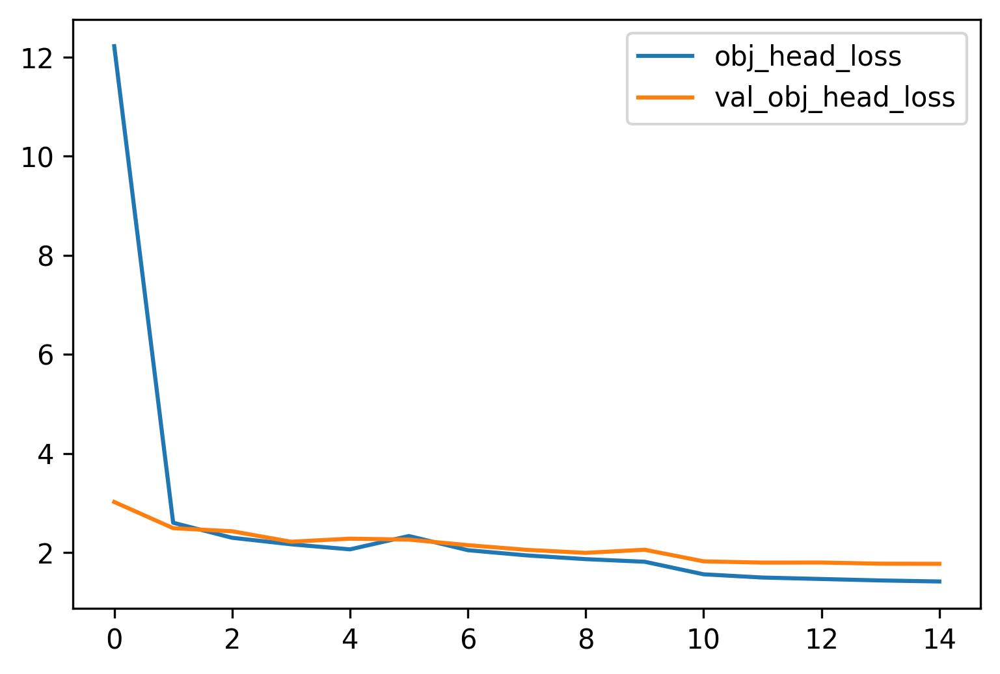

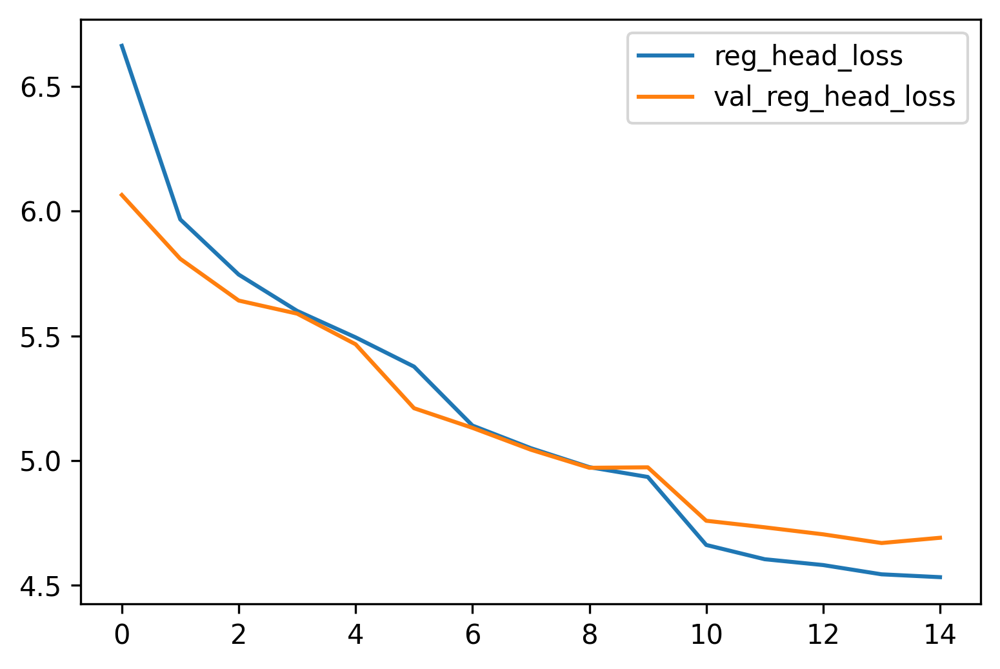

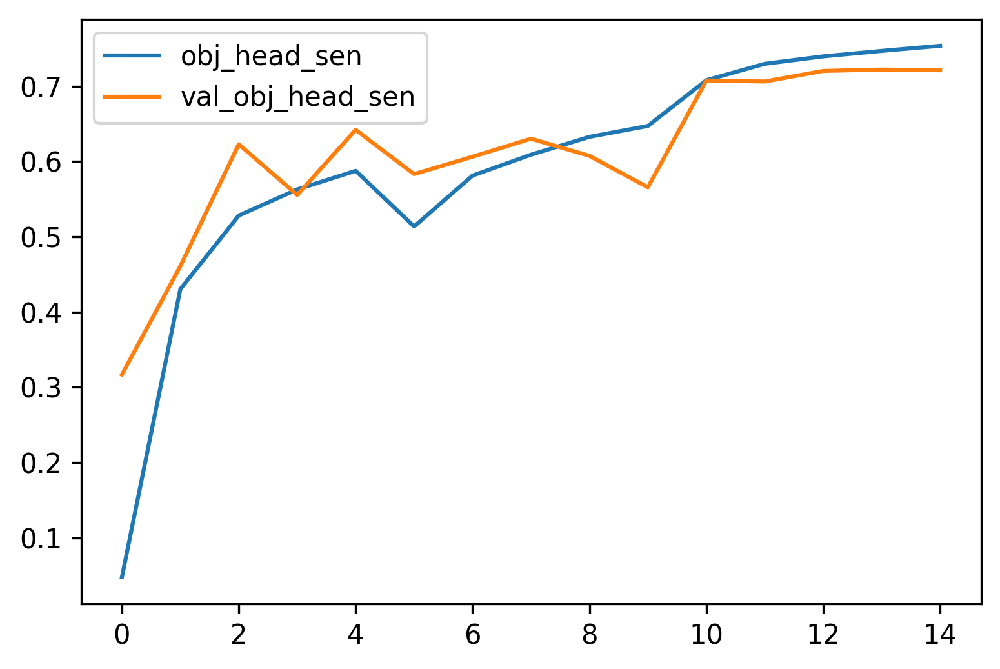

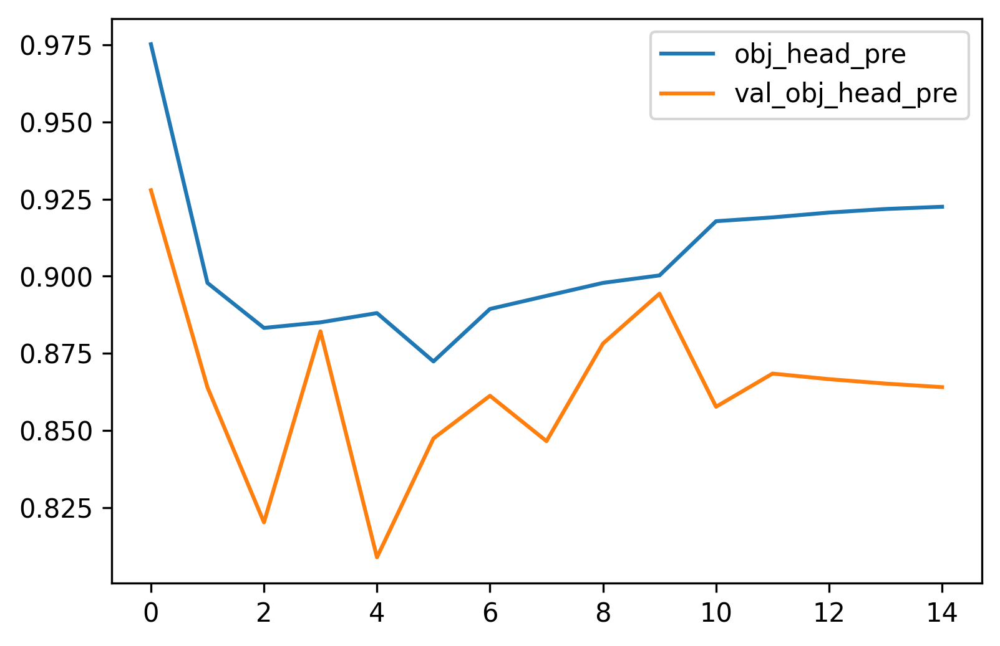

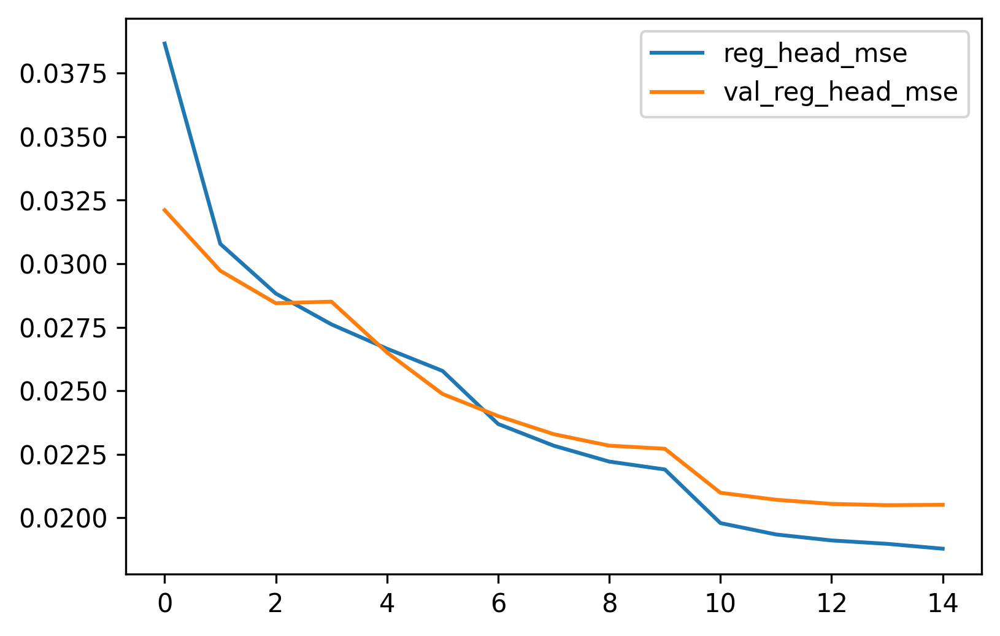

In [49]:
# this method displays the training history given by dictionary h
def displayTrainingResults(h):
    for k1, k2 in zip([h for h in h.keys() if 'val' not in h], 
                      [h for h in h.keys() if 'val' in h]):
        plt.figure(dpi=300)
        plt.plot(h[k1], label=k1)
        plt.plot(h[k2], label=k2)
        plt.legend()
        plt.show()
        
displayTrainingResults(h)

In the first two figures we can see that the loss initially decreases in a dramatic fashion - this is due to the large hyperparameter multiplying the negative anchor loss, thereby causing the RPN's 'objectness' head to focus almost exclusively on recognizing the background; meanwhile, the RPN's box regression head learns stably (see the third figure). After the first epoch the network slowly diverts its attention to the positive anchors and sensitivity increases gradually, as can be seen in the fourth figure. Throughout the whole training process, precision oscillates but remains high (see the fifth figure). We can also see some instability during the switch from feature extraction to fine-tuning but the network recuperated quickly, and convergence was reached.

Let's use the trained RPN to output some box predictions (sanity check)...

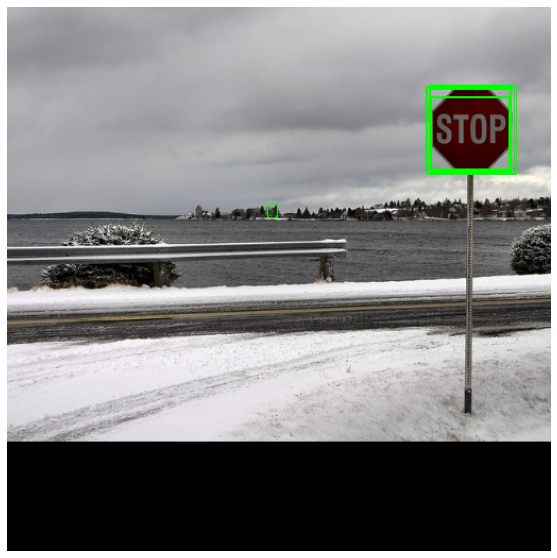

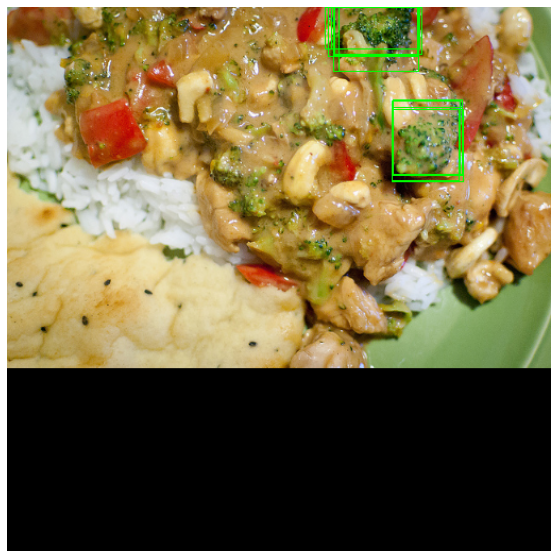

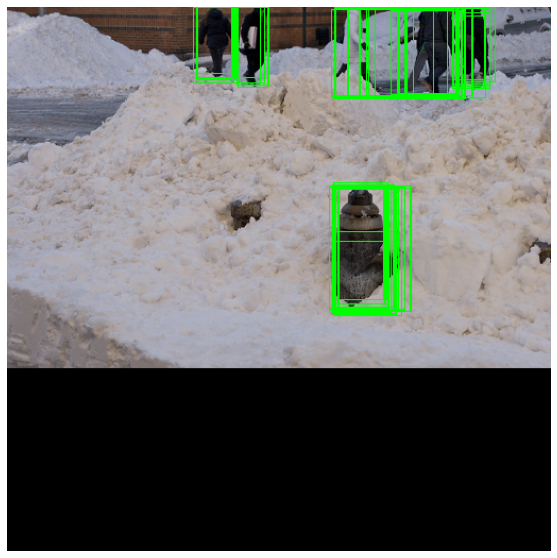

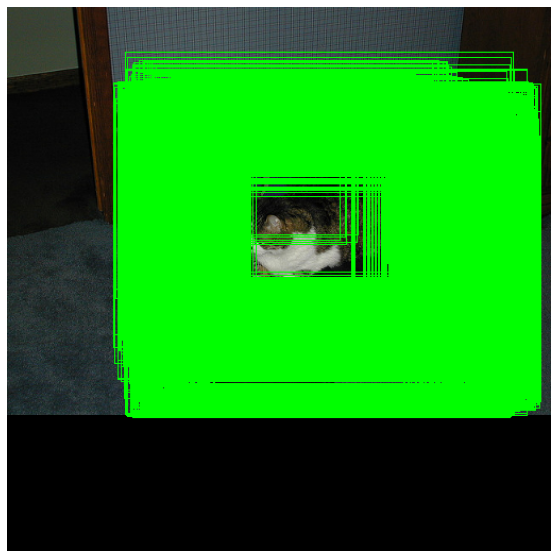

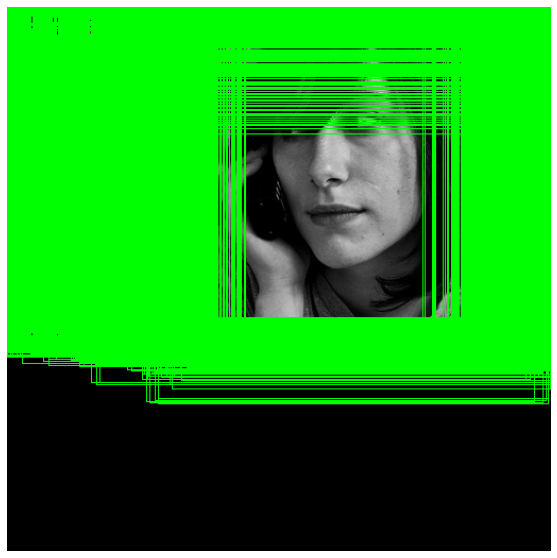

In [275]:
imgNum = 5
imgs = list(rpnValSet.take(1))[0][0].numpy()[:5]
scores, boxes = rpn.predict(imgs)
scores = np.reshape(scores[..., 0], (imgNum, -1, 1))
boxes = np.reshape(inversePrmBoxReg(boxes, gridAnchors), (imgNum, -1, 4)).astype(int) 
imgs = imgs.astype(int)
for i in range(len(imgs)):
    for j in range(len(scores[i])):
        if scores[i,j] > 0.5:
            b = boxes[i,j]
            cv2.rectangle(imgs[i], (b[0], b[1]), (b[2], b[3]), (0,255,0), 1)
    plt.figure(figsize=(10,10))
    plt.axis('off')
    plt.imshow(imgs[i])
    plt.show()

The boxes seem to be quite accurate, but extensive pruning is clearly necessary.

Now, let's repeat the process to train the detector; again, starting with the loss functions and metrics definitions...

In [89]:
# the detector's loss functions:
    
# this method calculates the loss of the classification head
def cls_loss(y_true, y_pred):
    scce = tf.keras.losses.SparseCategoricalCrossentropy()
    return scce(y_true[..., 0], y_pred)
    
    
# this method calculates the loss of the segmentation head
def seg_loss(y_true, y_pred):
    s = 10
    bce = tf.keras.losses.BinaryCrossentropy()
    y_true = y_pred[..., :1] # the sampled ground truth 
    y_pred = y_pred[..., 1:] # the segmentation prediction
    loss = bce(y_true, y_pred)
    return s * loss



# the detector's metrics:

# this method calculates the classification accuracy
def acc(y_true, y_pred):
    cls_true = y_true[..., 0]
    cls_pred = tf.cast(tf.argmax(y_pred, axis=-1), tf.float32)
    equal = tf.cast(tf.equal(cls_true, cls_pred), tf.float32)
    return equal

    
# this method calculates the IoU between the segmentation 
# prediction and the sampled ground truth segmentation mask
def iou(y_true, y_pred):
    # binarize the sampled ground truth
    y_true = tf.cast(tf.greater(y_pred[..., 0], 0.5), tf.float32)  
    # binarize the prediction
    y_pred = tf.cast(tf.greater(y_pred[..., 1], 0.5), tf.float32)
    pos_true = y_true
    neg_true = 1-y_true
    pos_pred = y_pred
    neg_pred = 1-y_pred
    TP = tf.reduce_sum(pos_true * pos_pred, axis=[1,2])
    FP = tf.reduce_sum(neg_true * pos_pred, axis=[1,2])
    FN = tf.reduce_sum(pos_true * neg_pred, axis=[1,2])
    return (TP + eps) / (TP + FP + FN + eps)

The two loss functions defined above are standard sparse categorical cross entropy [[13](https://www.tensorflow.org/api_docs/python/tf/keras/losses/SparseCategoricalCrossentropy)] and binary cross entropy; the former is used by the detector's classification head and the latter by the detector's segmentation head.

Metrics 'acc' and 'iou' calculate the classification accuracy and the segmentation pixel mask IoU between the segmentation prediction and the sampled ground truth segmentation mask, respectively. 

Note that a hyperparameter is used to give more weight to the segmentation loss because the classifier is more susceptible to overfitting.

Let's train the detector...

In [91]:
# train the detector
h = train(detector_train, 
          detector_encoder.get_layer('detector_encoder_pretrained'), 
          detectorTrainSet, 
          detectorValSet, 
          losses=[cls_loss, seg_loss], 
          metrics=[[acc], [iou]])


Training on extracted features using Adam...

Epoch 1/10
12882/12882 [==============================] - 4191s 325ms/step - loss: 5.8763 - cls_head_loss: 1.9101 - seg_concat_loss: 3.9662 - cls_head_acc: 0.5721 - seg_concat_iou: 0.7098 - val_loss: 4.5668 - val_cls_head_loss: 1.2265 - val_seg_concat_loss: 3.3403 - val_cls_head_acc: 0.6708 - val_seg_concat_iou: 0.7566
Epoch 2/10
12882/12882 [==============================] - 4154s 322ms/step - loss: 4.6293 - cls_head_loss: 1.2969 - seg_concat_loss: 3.3324 - cls_head_acc: 0.6518 - seg_concat_iou: 0.7474 - val_loss: 4.3713 - val_cls_head_loss: 1.1753 - val_seg_concat_loss: 3.1959 - val_cls_head_acc: 0.6809 - val_seg_concat_iou: 0.7641
Epoch 3/10
12882/12882 [==============================] - 4124s 320ms/step - loss: 4.4731 - cls_head_loss: 1.2554 - seg_concat_loss: 3.2177 - cls_head_acc: 0.6596 - seg_concat_iou: 0.7551 - val_loss: 4.3015 - val_cls_head_loss: 1.1649 - val_seg_concat_loss: 3.1366 - val_cls_head_acc: 0.6830 - val_seg_concat_io

We can see that classification accuracy isn't exceptionally high despite the relatively small number of classes and the large number of objects in the data - this is because most objects are small and contain little detail, while the warping effect of RoIAlign further increases the level of ambiguity. The segmentation mask IoU on the other hand, stands at about 80% which is quite high.

As before, let's display the training history...

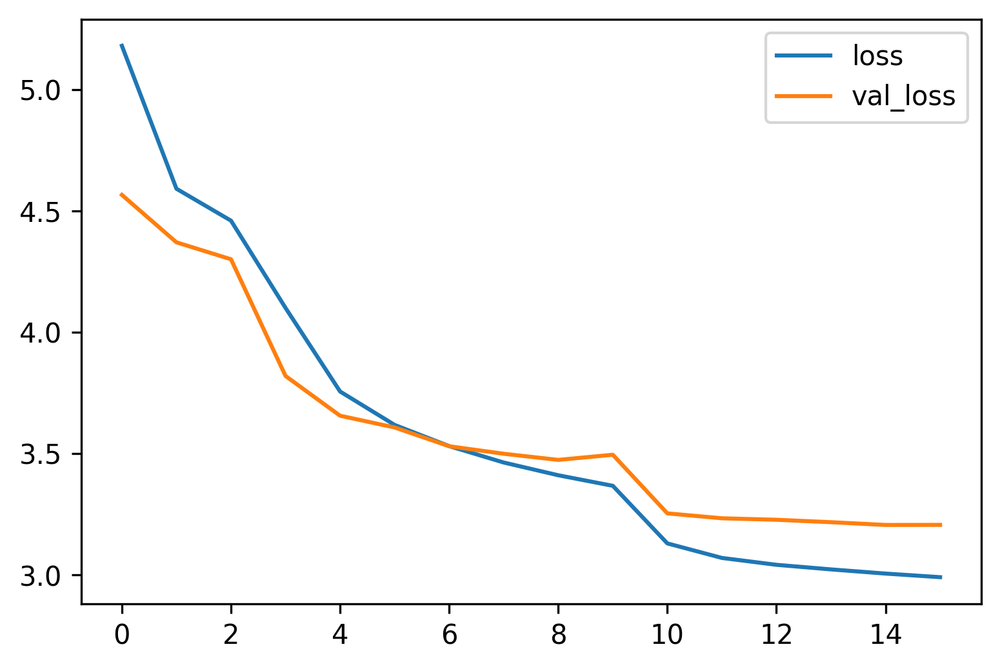

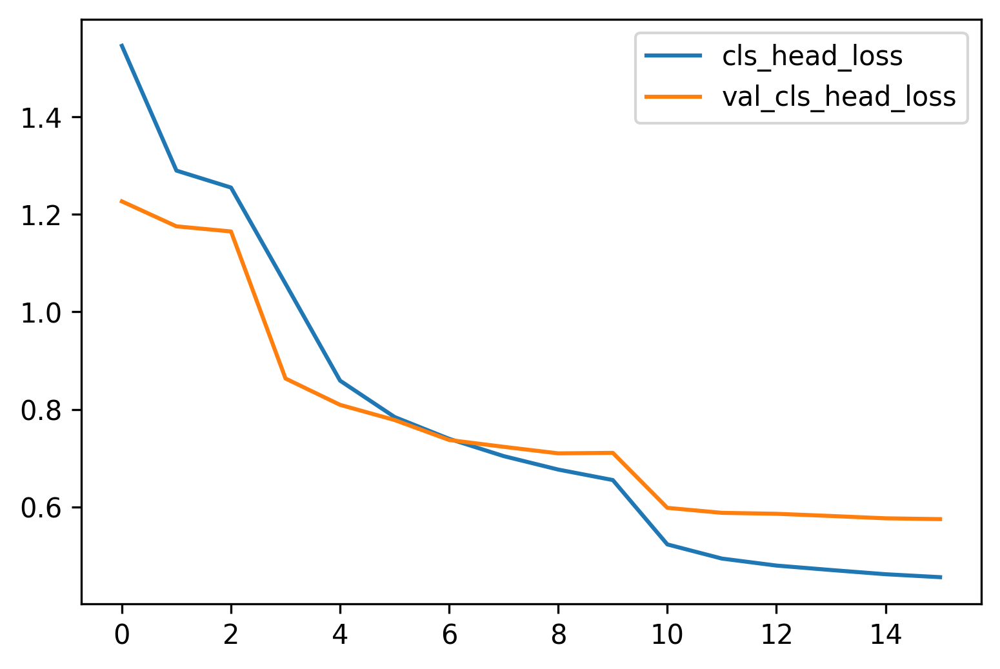

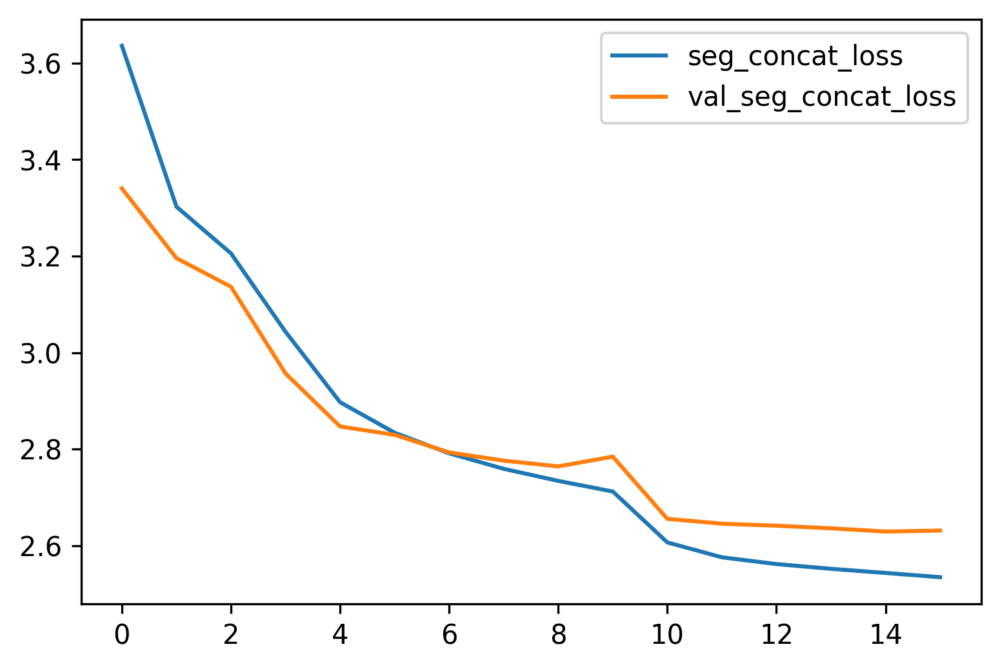

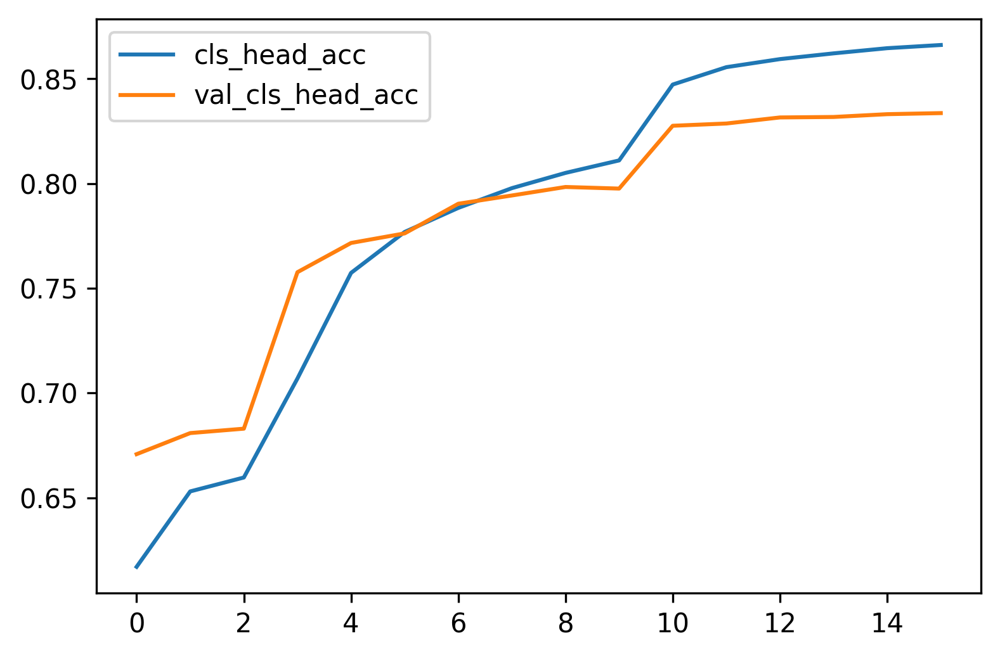

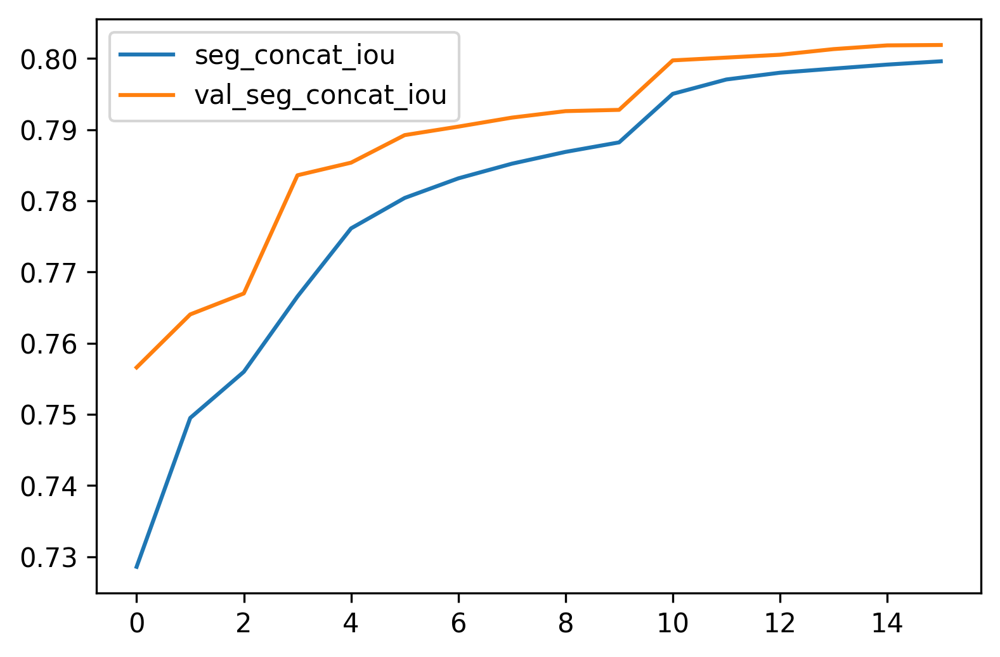

In [92]:
displayTrainingResults(h)

We can see that training was very stable and convergence was reached.

<a id='inf'></a>
## Inference

All the different parts of my Mask R-CNN model are now ready, so let's us the 'detector_infer' model on some test images before moving on to the evaluation phase...

In [163]:
# this method receives a list of images and uses the 'detector_infer' model to predict 
# appropriate boxes, scores, classes, and segmentation masks for each of them
def predict(imgs):
    preprocessed = []
    scales = []
    for img in imgs: # normalize the images' size and pad them 
        scale = imgSize / max(img.shape[:-1])
        scaleXY = (int(scale * img.shape[1]), int(scale * img.shape[0]))
        scales.append(np.array([[[scale]]]))
        preprocessed.append([pad(cv2.resize(img, scaleXY))])
    padded, scales = np.concatenate(preprocessed, axis=0), np.concatenate(scales, axis=0)
    box_pred = []
    scr_pred = []
    cls_pred = []
    seg_pred = []
    boxes, scores, segmentations = detector_infer.predict(padded)
    classes = np.argmax(scores, axis=-1)
    scores = np.max(scores, axis=-1)
    img_widths = np.array([img.shape[1] for img in imgs])
    img_heights = np.array([img.shape[0] for img in imgs])
    # rescale the boxes to account for the change in image size
    boxes = boxes / scales
    # clip the boxes according to the image's borders
    xmin = np.clip(boxes[..., 0], [0], img_widths[:,np.newaxis])
    ymin = np.clip(boxes[..., 1], [0], img_heights[:,np.newaxis])
    xmax = np.clip(boxes[..., 2], [0], img_widths[:,np.newaxis])
    ymax = np.clip(boxes[..., 3], [0], img_heights[:,np.newaxis])
    # round the box coordinates
    boxes = np.round(np.stack([xmin,ymin,xmax,ymax], axis=-1)).astype(int)
    widths = boxes[..., 2] - boxes[..., 0]
    heights = boxes[..., 3] - boxes[..., 1]
    for i in range(len(imgs)): # create lists of the final predictions
        box_pred.append([])
        scr_pred.append([])
        cls_pred.append([])
        seg_pred.append([])
        for bx, w, h, sc, cl, sg in zip(boxes[i], 
                                        widths[i], 
                                        heights[i], 
                                        scores[i],
                                        classes[i],
                                        segmentations[i]):
            if sc > 0.5 and w * h > minBoxArea: # tiny box predictions are usually just noise so ignore them
                box_pred[i].append(bx)
                scr_pred[i].append(sc)
                cls_pred[i].append(cl)
                # resize the predicted segmentation mask according to the dimensions of the predicted box
                sg = np.greater(cv2.resize(sg, (w, h)), 0.5).astype(float)
                temp = np.zeros(imgs[i].shape[:-1]).astype(np.uint8)
                temp[bx[1]:bx[3],bx[0]:bx[2]] = sg # place the segmentation prediction on a 'blank' image
                seg_pred[i].append(temp)
    return box_pred, scr_pred, cls_pred, seg_pred

The above method receives the original images, preprocesses them (by resizing and padding), and uses the 'detector_infer' model to predict boxes, class scores, and segmentation masks, which are then further processed to produce the final predictions; the boxes are scaled (to account for image size change), clipped, rounded, and tiny boxes are pruned (such boxes are usually just noise), final scores and class labels are produced according to the maximum class scores, and the segmentation masks are resized and binarized according to the boxes' dimensions.

In [278]:
import seaborn as sns


# map int to class name (this is needed to display the class name with the bounding box)
catIntToName = {i : c['name'] for i, c in enumerate(cats)}

# this method receives the 'detector_infer' model's predictions and draws the results on top of the received images
# (draws the original image followed by an interpolation of the original image and the segmentation results,
# along with the boxes, class names, and scores)
def draw(imgs, 
         dBox=True, dTxt=True, dSeg=True, # whether to display boxes/text/segmentations
         bThick=1, bColor=(255,255,255), txtSize=0.4): # the box color, thickness, and text size
    box_pred, scr_pred, cls_pred, seg_pred = predict(imgs)
    for i in range(len(imgs)): # create a random color palette for the segmentations
        palette = (np.array(sns.color_palette(
            "dark", len(box_pred[i]))) * 255)
        drawImg = 0.5 * imgs[i] # a 'faded' image
        for bx, sc, cl, sg, pl in zip(box_pred[i],
                                      scr_pred[i], 
                                      cls_pred[i], 
                                      seg_pred[i],
                                      palette):
            if dBox: # draw the box
                cv2.rectangle(drawImg, (bx[0], bx[1]), (bx[2], bx[3]), bColor, bThick)
            if dTxt: # draw text (class name and score)
                cv2.putText(
                    drawImg, 
                    catIntToName[cl] + ': ' + str(round(sc, 2)), 
                    (bx[0], bx[1]-4),
                    cv2.FONT_HERSHEY_SIMPLEX, 
                    txtSize, 
                    bColor
                )
            if dSeg: # superimpose the colored segmentations on the 'faded' image
                drawImg[bx[1]:bx[3],bx[0]:bx[2]] += (sg[bx[1]:bx[3],bx[0]:bx[2]][...,np.newaxis] * 
                                                     pl[np.newaxis,np.newaxis,:]) 
        # clip image values since segmentations might overlap and produce values > 255
        drawImg = np.clip(drawImg.astype(int), 0, 255) 
        # draw the original image followed by the 'faded' version with the superimposed segmentations
        for img in [imgs[i], drawImg]:
            plt.figure(figsize=(10,10))
            plt.imshow(img)
            plt.axis('off')
            plt.show()

The above method uses the previously defined 'predict' method to make predictions which are then illustrated by displaying the original images alongside their 'faded' versions with superimposed boxes, scores, class names, and colored segmentations.

Now, let's use the last two methods to display some predictions on images from the test set...

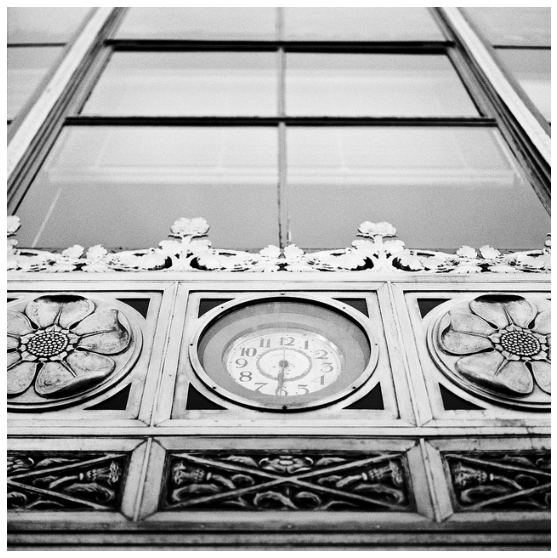

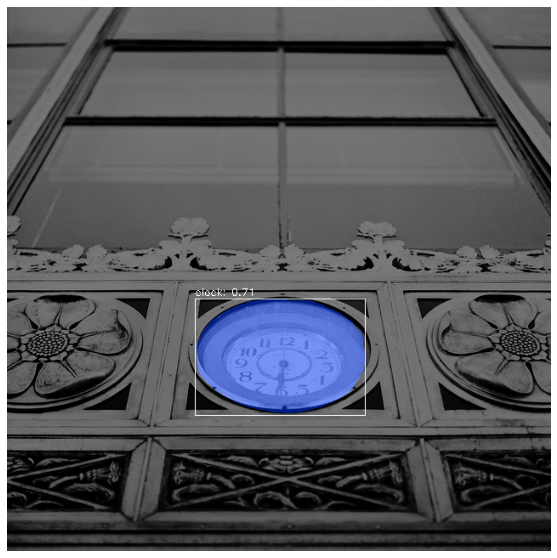

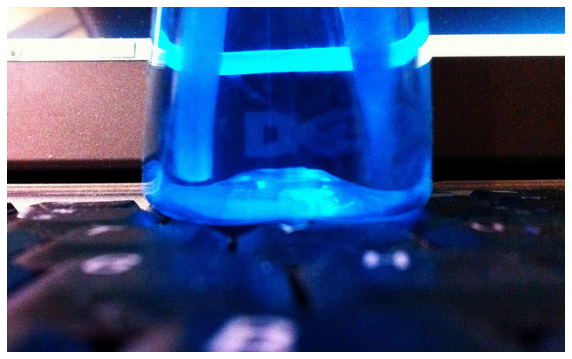

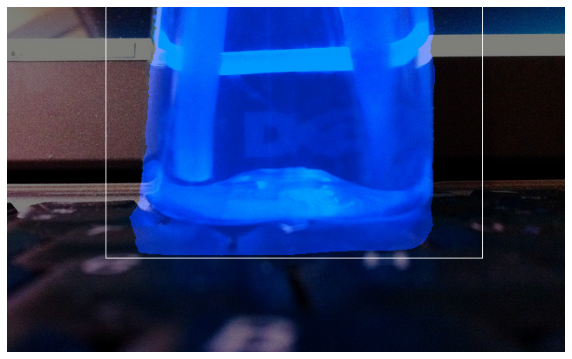

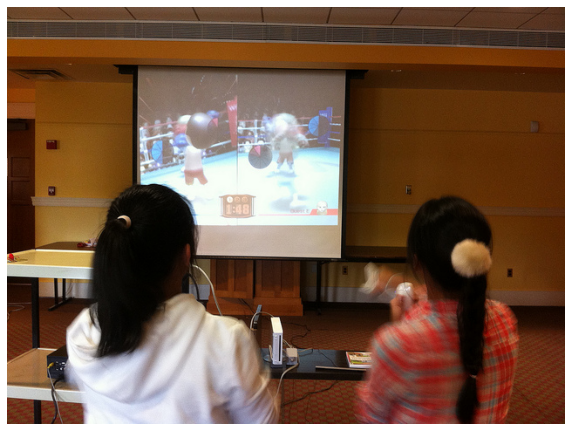

...

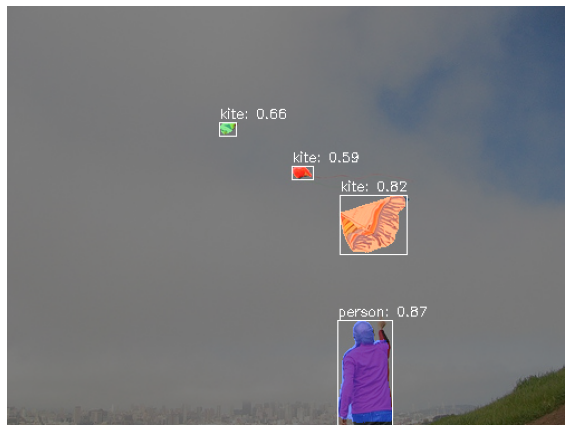

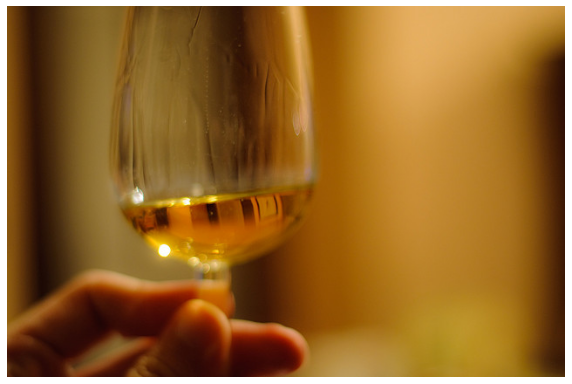

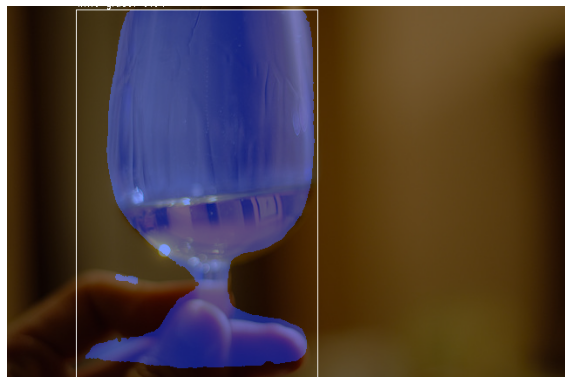

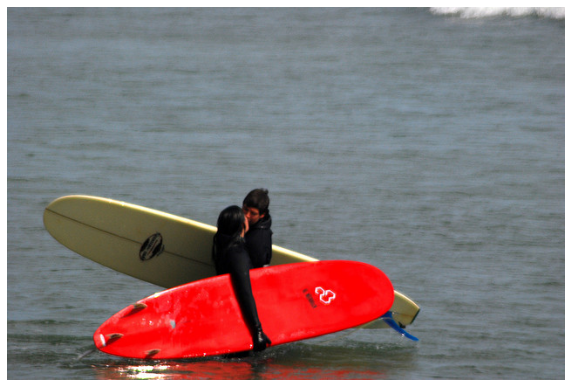

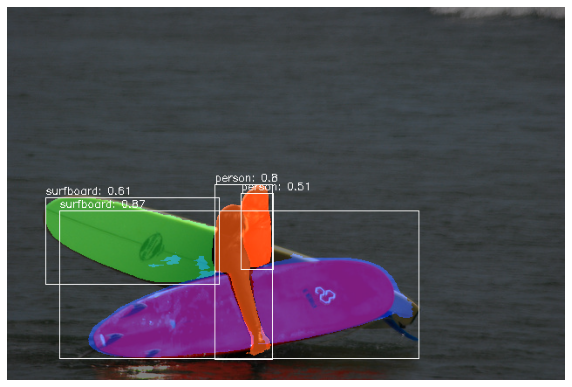

In [280]:
import os

def listFiles(dir):
    r = []
    for root, dirs, files in os.walk(dir):
        r.append((root, dirs, files))
    return r

imgNames = random.sample(listFiles(testImgPath)[0][2], 10) # randomly select some test images
imgs = [cv2.cvtColor(cv2.imread(testImgPath+n), cv2.COLOR_BGR2RGB) for n in imgNames]
for img in imgs:
    draw([img])

The results are not perfect, but it's clear that the network has learned to perform the desired task.

The API of [[3](https://cocodataset.org/#home)] contains methods for evaluation; unfortunately, I encountered some technical issues running the relevant code (e.g., some NumPy calls generate errors in later versions), so I implemented an appropriate evaluation procedure myself which is defined in the following code segment:

In [205]:
# this method receives a COCO object, file path, and COCO image metadata, fetches the annotations of the 
# corresponding images, and uses the detector_infer model to make predictions - these along with the annotations 
# are used to calculate three tensors of shape (i,t,s,c) containing the number of true positives, false positives, 
# and positives, respectively, for each image (i), IoU threshold (t), object size (s), and class (c). 
# TP and FP are determined according to the IoU threshold.
# the area_thresholds determine the size category of each object 
# (area < area_thresholds[0] belongs to the smallest category).
# TP, FP, P are then used to calculate the precision and recall tensors - these are returned by the method.
def evalSeg(coco, path, cocoImgs, IoU_thresholds, area_thresholds):
    # calculates the segmentation mask IoU between t and p
    def maskIoU(t, p):
        TP = np.sum(t * p, axis=(1,2))
        FP = np.sum((1-t) * p, axis=(1,2))
        FN = np.sum(t * (1-p), axis=(1,2))
        return (TP + eps) / (TP + FP + FN + eps)
    # this sub-routine receives the correct classes and segmentations (cls_t, seg_t), and the predicted
    # scores, classes and segmentations (cls_p, seg_p), and calculates the number of true positives, 
    # false positives, and positives in the relevant image
    def TP_FP_P(cls_t, seg_t, cls_p, seg_p): 
        # init TP, FP, P
        TP = np.zeros((len(IoU_thresholds),len(area_thresholds)+1,clsNum))
        FP = np.zeros((len(IoU_thresholds),len(area_thresholds)+1,clsNum))
        P = np.zeros((len(area_thresholds)+1,clsNum,))
        if len(cls_t): # are there any ground truths?
            area_t = np.sum(seg_t, axis=(1,2)) # get the areas of the segmentation ground truths
            area_t_idx = np.sum(area_t[:,np.newaxis] > area_thresholds[np.newaxis], axis=-1)
            unique, counts = np.unique(np.stack([area_t_idx, cls_t], axis=-1), axis=0, return_counts=True)
            P[unique[:,0],unique[:,1]] = counts
        if len(cls_p): # are there any predictions?
            area_p = np.sum(seg_p, axis=(1,2)) # get the areas of the segmentation predictions
            area_p_idx = np.sum(area_p[:,np.newaxis] > area_thresholds[np.newaxis], axis=-1)
            matched = np.zeros((len(cls_t),), np.bool)
            for i in range(len(cls_p)): # look for a ground truth match for every prediction
                IoU_idx = 0
                try:
                    IoU = maskIoU(seg_t, seg_p[i][np.newaxis,...])
                    bestIdx = np.argmax(IoU)
                    if cls_p[i] == cls_t[bestIdx]: # classes match?
                        bestIoU = np.max(IoU)
                        IoU_idx = np.sum(bestIoU > IoU_thresholds) # count passed IoU thresholds
                        if not matched[bestIdx]:
                            TP[:IoU_idx, area_t_idx[bestIdx], cls_t[bestIdx]] += 1
                            matched[bestIdx] = True
                except:
                    pass # no ground truths? all FP
                FP[IoU_idx:, area_p_idx[i], cls_p[i]] += 1
        return TP, FP, P
    TP = [] 
    FP = []
    P = []
    # call sub-routine TP_FP_P for each image:
    for i, cocoImg in enumerate(cocoImgs): 
        anns = coco.loadAnns(coco.getAnnIds(cocoImg['id'])) 
        anns = [a for a in anns if a['iscrowd'] == 0 and a['bbox'][2] * a['bbox'][3] > minBoxArea]
        cls_true = np.array([catIdToInt[a['category_id']] for a in anns])
        seg_true = np.array([coco.annToMask(a) for a in anns])
        img = [cv2.cvtColor(cv2.imread(path+cocoImg['file_name']), cv2.COLOR_BGR2RGB)]
        _, _, cls_pred, seg_pred = predict(img)
        cls_pred = np.array(cls_pred[0])
        seg_pred = np.array(seg_pred[0])
        tp, fp, p = TP_FP_P(cls_true, seg_true, cls_pred, seg_pred)
        TP.append(tp)
        FP.append(fp)
        P.append(p)
        print('Images evaluated: '+str(i+1), end='\r')
    print()
    TP = np.stack(TP, axis=0)
    FP = np.stack(FP, axis=0)
    P = np.repeat(np.stack(P, axis=0)[:,np.newaxis], len(IoU_thresholds), axis=1)
    pre = (TP + eps) / (TP + FP + eps) * ((TP > 0) | (FP > 0)) # calculate precision
    rec = (TP + eps) / (P + eps) * (P > 0) # calculate recall
    return pre, rec

The above method receives a list of COCO images (i.e., image metadata) and an appropriate COCO object and file path, and uses the 'detector_infer' model to make predictions just like before; this time, however, the predictions and their corresponding ground truth annotations are sent to a sub-routine aptly called 'TP_FP_P', that counts the number of true positives, false positives and positives with respect to the supplied IoU thresholds. In addition, the method receives area thresholds to determine to which size group every prediction belongs (e.g., 'small' segmentation areas are less than the first threshold). To summarize, the method generates three tensors TP, FP, P of shape (i,t,s,c) containing the number of TP, FP, and P for every image (i), IoU threshold (t), object size (s), and class (c) - these are then used to calculate two other tensors called 'pre' and 'rec' of the same shape, which contain the precision and recall results, respectively, and can be readily used to calculate average precision (AP) and average recall (AR) results along the various axes.

Note that the method calculates IoU with respect to the segmentation masks rather than the boxes, since instance segmentation is the main function of the Mask R-CNN solution; clearly, successful segmentation requires accurate box predictions, and so they are indirectly put to the test as well.

 Now, let's check some AP and AR results on the entire validation set which contains exactly 5,000 images...

In [299]:
# this method receives the tensors returned by the previous method (i.e., evalSeg),
# calculates average precision and recall measures along the given axes.
# names and title can be provided to display appropriate histograms
def display_AP_AR_results(pre, rec, axis=(0,1,2,3), names=[], title=''):
    AP = (np.sum(pre, axis=axis) + eps) / (np.count_nonzero(pre, axis=axis) + eps) # calculate AP along the given axes
    AR = (np.sum(rec, axis=axis) + eps) / (np.count_nonzero(rec, axis=axis) + eps) # calculate AR along the given axes
    try:
        # display appropriate AP and AR histograms
        apDF = pd.DataFrame(
            data=[[names[i], ap] 
                  for i, ap, in enumerate(AP)], 
            columns=[title, 'AP']).sort_values(by='AP').set_index(title)
        apDF.columns.name = 'AP by ' + title 
        arDF = pd.DataFrame(
            data=[[names[i], ar] 
                  for i, ar, in enumerate(AR)], 
            columns=[title, 'AR']).sort_values(by='AR').set_index(title)
        arDF.columns.name = 'AR by ' + title
        for df in [apDF, arDF]:
            fig = plt.figure(figsize=(10,10), dpi=100)
            ax = fig.gca()
            plt.xlim((0,1))
            ax.set_xticks(np.arange(0, 1, 0.1))
            df.plot(kind='barh', fontsize=8, title=df.columns.name, ax=plt.gca())
            plt.grid(axis='x')
            ax.get_legend().remove()
            plt.show();
    except:
        pass
    return AP, AR

The above method receives the aforementioned 'pre' and 'rec' tensors and an axis tuple and calculates appropriate AP and AR results; the method will also try to display appropriate histograms as we will see. Let's call the method and check the overall AP and AR first...

In [207]:
IoU_thresholds = np.round(np.array([0.5+i*0.05 for i in range(10)]), 2)
area_thresholds = np.array([32**2, 96**2])
pre, rec = evalSeg(
    valCOCO, valImgPath, valImgs, IoU_thresholds=IoU_thresholds, area_thresholds=area_thresholds)
print("AP: {}\nAR: {}".format(*np.round(display_AP_AR_results(pre, rec), 3)))

Images evaluated: 5000
AP: 0.46
AR: 0.246


On the one hand, the AP surpasses the results presented in [[1](https://arxiv.org/abs/1703.06870)], even though my implementation is a bit simpler and uses a lightweight encoder; on the other hand, the AR is not very impressive - this isn't entirely surprising as I trained the network to be highly specific. Unfortunately, there are no AR results to be found in [[1](https://arxiv.org/abs/1703.06870)] which is a bit strange since any one of these two measures is not very useful on its own; I suspect that the original Mask R-CNN achieves much better AR than what I presented here. Anyway, there is no doubt that a lot more tweaking is required to improve the results if one is to compete with state-of-the-art solutions.

Now, let's drill down by averaging across the different axes of the results to obtain a more detailed evaluation...

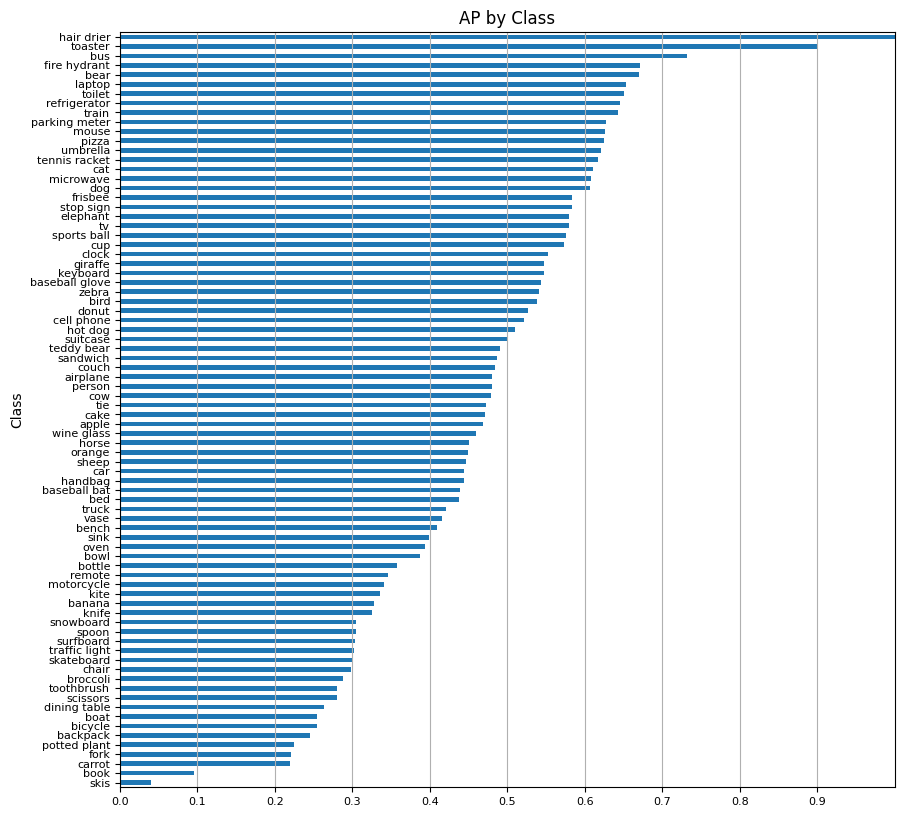

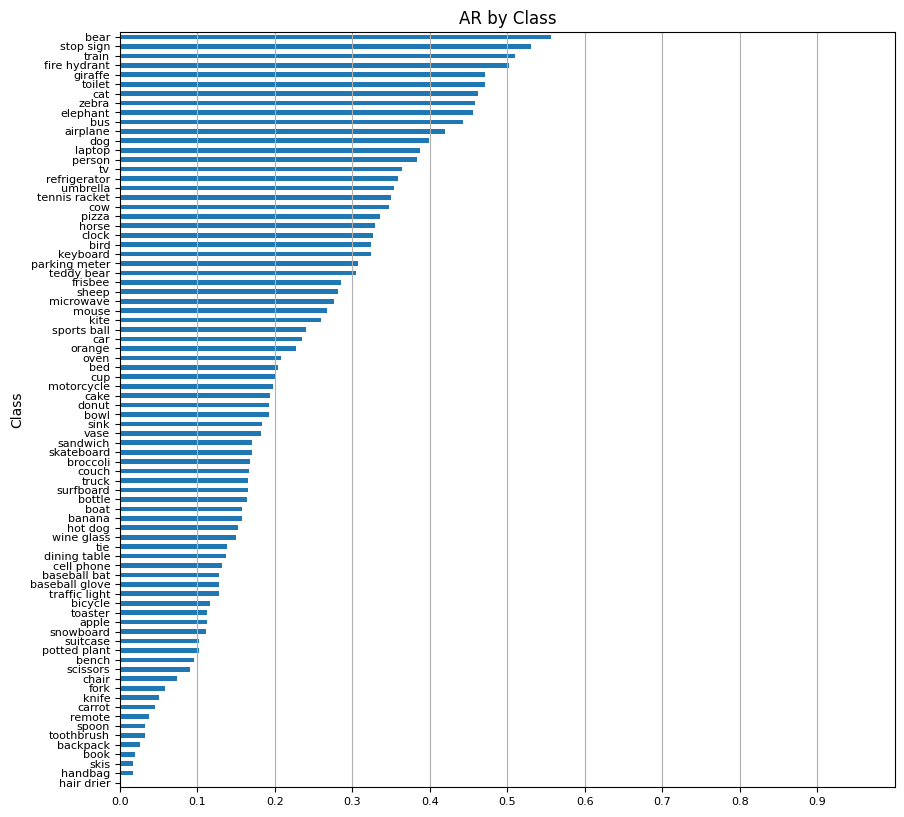

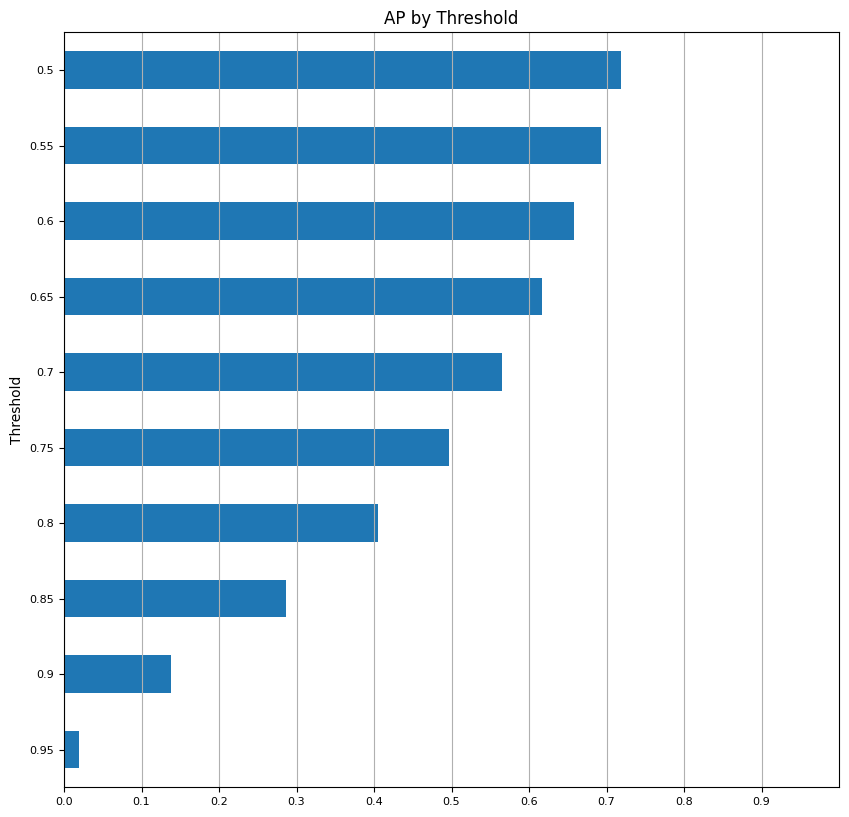

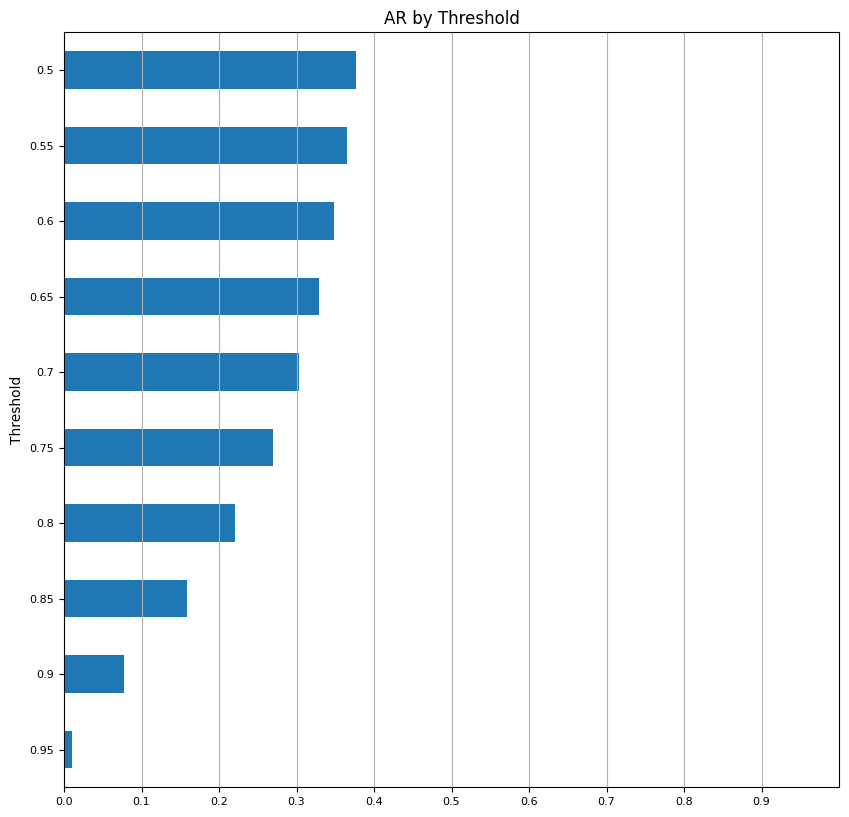

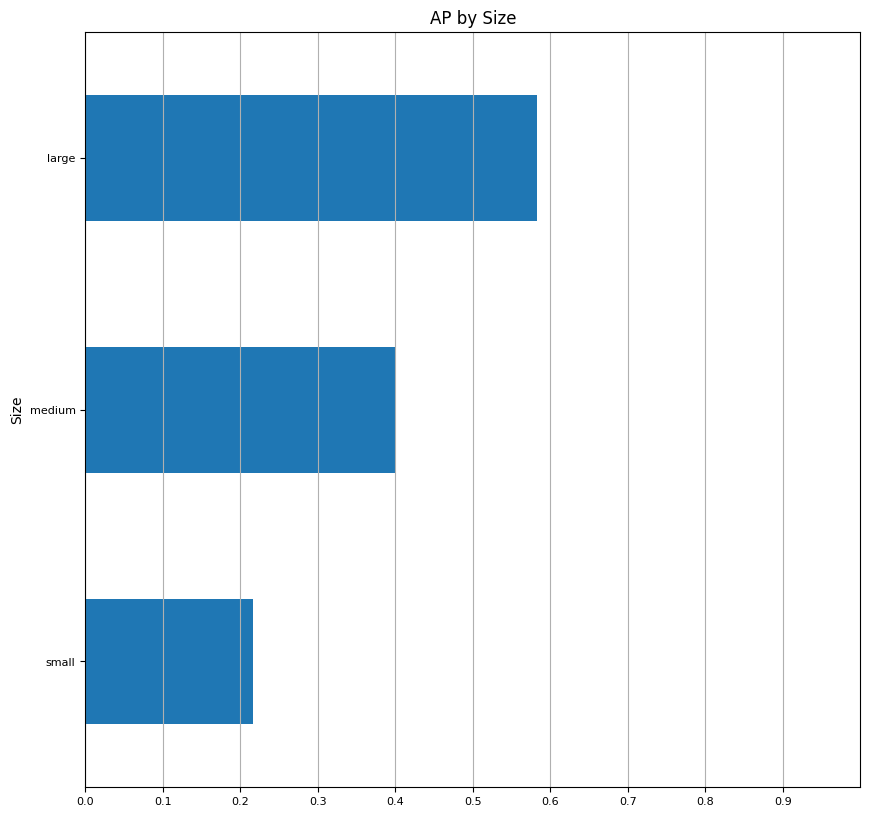

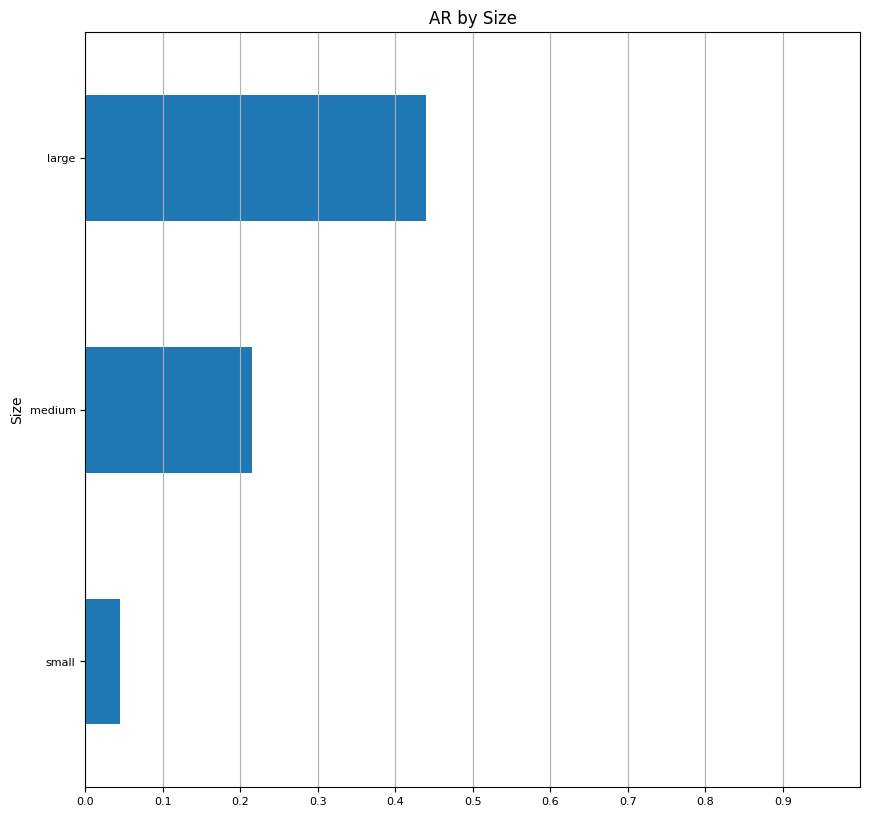

In [300]:
AP, AR = display_AP_AR_results(
    pre, rec, axis=(0,1,2), 
    names=list(catIntToName.values()), 
    title='Class')

AP, AR = display_AP_AR_results(
    pre, rec, axis=(0,2,3), 
    names=[str(t) for t in IoU_thresholds], 
    title='Threshold')

AP, AR = display_AP_AR_results(
    pre, rec, axis=(0,1,3), 
    names=['small','medium','large'], 
    title='Size')

In the above figures we can see more specific AP and AR results with respect to the various classes, object sizes, and IoU thresholds. We can see that the network was not able to detect any hair driers (i.e., AP = 1, AR = 0), but it should not come as a surprise at all since these are quite uncommon in the training set. Interestingly, some classes were much harder to detect than others, even though they are far more common in the training set (e.g., 'person' vs 'bear'); it seems that some classes are particularly challenging while others don't have as much variance in the data. The next two figures show the AP and AR for each IoU threshold; segmenting objects perfectly (IoU > 0.95) is incredibly difficult for my network - this difficulty might be exacerbated by my choice to sample from the ground truth segmentation mask rather than resizing the sampled features. Finally, in the last two figures we can see the AP and AR with respect to object size; the network has trouble detecting smaller objects, which is very much to be expected since I use relatively small images to train the network. Overall, the results are decent, and no special or unexpected anomalies can be observed.

As a final test, let's check the inference speed of the 'detector_infer' model...

In [209]:
dummy = np.empty([1,imgSize,imgSize,3])

Only a dummy image is needed to test inference speed...

In [210]:
%%timeit -n 1 -r 1000
detector_infer(dummy)

178 ms ± 2.04 ms per loop (mean ± std. dev. of 1000 runs, 1 loop each)


The inference speed stands at about 5-6 fps on my 3060 RTX 12GB GPU, which is like the results shown in [[1](https://arxiv.org/abs/1703.06870)].

Note that inference speed can be improved significantly by simply decreasing the number of segmentation masks the network produces per image (most images contain less than 64 objects anyway).

<a id='dis'></a>
## Discussion 

Image segmentation is one of the most well-known and challenging problems in computer vision, and I have been intrigued by it since I had begun taking advanced university courses in the field of artificial intelligence such as computational biology, data science, and even computer graphics. Mask R-CNN is considered to have made a breakthrough in this area, which is why I decided to implement it as a way of gaining practical experience in working with Keras and TensorFlow deep learning libraries.

It should be clear to anyone familiar with the original implementation that mine is quite different, though the core ideas are the same; the network is composed of two parts - a region proposal network which proposes bounding boxes, and a detector which classifies and segments the objects contained in them. I tried to simplify and add some of my own ideas wherever I thought it was appropriate. For example, in [[1](https://arxiv.org/abs/1703.06870)] the detector has a third head that further corrects the boxes proposed by the RPN, while in my implementation the RPN produces the final boxes - this makes it quite easy to decouple the RPN and the detector as they can be viewed as separate and independent networks - the RPN determines 'objectness' and regresses boxes, whereas the detector performs classification and binary segmentation of warped images. Another notable improvement is the use of a better anchor prior by running k-means clustering rather than making do with manually selected anchor sizes and aspect ratios - I noticed significant improvement in the RPN's ability to correctly regress the anchors after adding this seemingly trivial step. I also left out a few things for simplicity's sake and inference speed as well. For example, the boxes predicted by the RPN are pruned by non-maximum suppression using the 'objectness' scores; a more sophisticated approach involves running another non-maximum suppression procedure while taking the detector's class score predictions into consideration as well - this way pruning can be done for each class separately, and thus objects of different classes that happen to occlude one another would be easier to detect, thereby increasing recall at a small risk of decreasing precision. Another obvious choice I made is the use of relatively small images - this certainly limits the potential performance of the network, but there is hardly a more efficient way to speed things up. Still, training times of such networks measure in many hours, or even days as is evident in this project.

I have been working on this project for a long time and have learned a lot from doing it. All in all, it was a very challenging and rewarding experience that required plenty of revisions in core network architecture, tinkering with different network optimization algorithms, a lot of hyperparameter tuning, and more. As I said, many things can still be improved, but I am quite happy with the results that seem to be on par with what was achieved in [[1](https://arxiv.org/abs/1703.06870)].

<a id='ref'></a>
## References

[1] Kaiming He, Georgia Gkioxari, Piotr Dollár, Ross Girshick, "Mask R-CNN", https://arxiv.org/abs/1703.06870

[2] Aurélien Géron, "Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow: Concepts, Tools, and Techniques to Build Intelligent Systems 2nd Edition", https://www.amazon.com/Hands-Machine-Learning-Scikit-Learn-TensorFlow/dp/1492032646/ref=sr_1_1?dchild=1&keywords=machine+learning&qid=1633241659&sr=8-1

[3] https://cocodataset.org/#home

[4] https://en.wikipedia.org/wiki/Jaccard_index

[5] Shaoqing Ren, Kaiming He, Ross Girshick, Jian Sun, "Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks", https://arxiv.org/abs/1506.01497

[6] https://keras.io/api/applications/resnet/#resnet50v2-function

[7] Tsung-Yi Lin, Piotr Dollár, Ross Girshick, Kaiming He, Bharath Hariharan, Serge Belongie, "Feature Pyramid Networks for Object Detection", https://arxiv.org/abs/1612.03144

[8] Rajeev Ranjan, Carlos D. Castillo, Rama Chellappa, "L2-constrained Softmax Loss for Discriminative Face Verification", https://arxiv.org/abs/1703.09507

[9] https://www.tensorflow.org/api_docs/python/tf/image/combined_non_max_suppression

[10] https://www.tensorflow.org/api_docs/python/tf/keras/losses/BinaryCrossentropy

[11] Tsung-Yi Lin, Priya Goyal, Ross Girshick, Kaiming He, Piotr Dollár, "Focal Loss for Dense Object Detection", https://arxiv.org/pdf/1708.02002.pdf

[12] Ashia C. Wilson, Rebecca Roelofs, Mitchell Stern, Nathan Srebro, Benjamin Recht, "The Marginal Value of Adaptive Gradient Methods in Machine Learning", https://arxiv.org/abs/1705.08292

[13] https://www.tensorflow.org/api_docs/python/tf/keras/losses/SparseCategoricalCrossentropy

[14] https://www.tensorflow.org/tutorials/images/transfer_learning

[15] https://keras.io/api/optimizers/adam/

[16] https://keras.io/api/optimizers/sgd/

[17] https://keras.io/api/layers/activation_layers/elu/

[18] https://www.tensorflow.org/api_docs/python/tf/keras/losses/Huber

[19] https://www.tensorflow.org/api_docs/python/tf/keras/losses/MeanSquaredError

[20] https://www.tensorflow.org/api_docs/python/tf/keras/losses/MeanAbsoluteError

[21] https://keras.io/api/callbacks/early_stopping/

<a id='app'></a>
## Appendix:

This can be used to save the RPN's encoder and its heads:

In [ ]:
rpn_encoder.save(path+'rpn_encoder.hdf5')
rpn_obj.save(path+'rpn_obj.hdf5')
rpn_reg.save(path+'rpn_reg.hdf5')

This can be used to load the RPN's encoder and its heads:

In [267]:
rpn_encoder = tf.keras.models.load_model(
    path+"rpn_encoder.hdf5", compile=False, custom_objects={'Augment' : Augment})
rpn_obj = tf.keras.models.load_model(
    path+"rpn_obj.hdf5", compile=False)
rpn_reg = tf.keras.models.load_model(
    path+"rpn_reg.hdf5", compile=False)

This can be used to save the detector's encoder and its heads:

In [ ]:
detector_encoder.save(path+'detector_encoder.hdf5')
detector_cls.save(path+'detector_cls.hdf5')
detector_seg.save(path+'detector_seg.hdf5')

This can be used to load the detector's encoder and its heads:

In [268]:
detector_encoder = tf.keras.models.load_model(
    path+"detector_encoder.hdf5", compile=False, custom_objects={'Augment' : Augment})
detector_cls = tf.keras.models.load_model(
    path+"detector_cls.hdf5", compile=False)
detector_seg = tf.keras.models.load_model(
    path+"detector_seg.hdf5", compile=False)